In [31]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import pairwise_distances
from sklearn import preprocessing as prep

# 5000Songs Example

## Import songs_df

In [32]:
songs_df = pd.read_csv("..\datasets\df_audio_features_5000.csv")
songs_df.columns = songs_df.columns.str.strip()

In [33]:
songs_df

,name,artist,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,duration_ms,time_signature,id,html
0,Se Eu Quiser Falar Com Deus ...,Gilberto Gil,0.6580,0.25900,11,-13.141,0,0.0705,0.694,0.000059,0.9750,0.3060,110.376,,256213,4,1n7JnwviZ7zf0LR1tcGFq7,https://open.spotify.com/track/1n7JnwviZ7zf0LR...
1,Saudade De Bahia ...,Antônio Carlos Jobim,0.7420,0.39900,2,-12.646,1,0.0346,0.217,0.000002,0.1070,0.6930,125.039,,191867,4,5QGM1U0eCYrQuwSJwTm5Zq,https://open.spotify.com/track/5QGM1U0eCYrQuwS...
2,"Canta Canta, Minha Gente ...",Martinho Da Vila,0.8510,0.73000,2,-11.048,1,0.3470,0.453,0.000063,0.1240,0.9050,93.698,,152267,4,0NLIFSZxPzQhCwnkn5PJYs,https://open.spotify.com/track/0NLIFSZxPzQhCwn...
3,Mulher Eu Sei ...,Chico César,0.7050,0.05020,4,-18.115,1,0.0471,0.879,0.000041,0.3860,0.5240,106.802,,186227,4,3mXqOdlLE1k67WsAxryPFs,https://open.spotify.com/track/3mXqOdlLE1k67Ws...
4,Rosa Morena ...,Kurt Elling,0.6510,0.11900,6,-19.807,1,0.0380,0.916,0.000343,0.1040,0.4020,120.941,,273680,4,7bSzjzjTkWT2CkIPPdp0eA,https://open.spotify.com/track/7bSzjzjTkWT2CkI...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5230,"1812 Festival Overture, Op. 49: 1812 Overture,...",Pyotr Ilyich Tchaikovsky,0.2020,0.06940,3,-23.390,1,0.0473,0.917,0.715000,0.0832,0.0655,87.906,,995000,4,1aEhYlZtypmipA06SDJ4U3,https://open.spotify.com/track/1aEhYlZtypmipA0...
5231,"Winter Fragments pour ensemble instrumental, s...",Tristan Murail,0.1880,0.10100,6,-21.873,1,0.0442,0.855,0.426000,0.0694,0.0355,83.134,,855000,4,1Gfqe7TAKklmuZf6hxsH6h,https://open.spotify.com/track/1Gfqe7TAKklmuZf...
5232,"Schoenberg: 5 Orchestral Pieces, Op. 16: No. 3...",Arnold Schoenberg,0.0596,0.00093,9,-42.959,1,0.0434,0.951,0.969000,0.0772,0.0344,71.573,,238187,3,2XNwnFrdMDpismp0VUZ7cU,https://open.spotify.com/track/2XNwnFrdMDpismp...
5233,"Serenade For Strings In E, Op.22, B. 52: 1. Mo...",Antonín Dvořák,0.1330,0.02080,4,-29.443,1,0.0419,0.883,0.505000,0.1110,0.0591,67.109,,314307,4,7ucDwgMtE3YJtEfTbuRhy0,https://open.spotify.com/track/7ucDwgMtE3YJtEf...


### Decide for some features
Keep the following

- **energy**
is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale. Perceptual features contributing to this attribute include dynamic range, perceived loudness, timbre, onset rate, and general entropy.	Float

- ~~**speechiness**
detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks.	Float~~

- **loudness**
The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks. Loudness is the quality of a sound that is the primary psychological correlate of physical strength (amplitude). Values typically range between -60 and 0 db.	Float

- **acousticness**
A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.	Float


- **tempo**
The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration.	Float


In [34]:
feat_l = ["energy","acousticness","tempo","loudness"]

### Remove outliers

In [35]:
def analyze_outliers(df,col,action="keep"):
    Q1   = col.quantile(0.25)
    Q3   = col.quantile(0.75)
    IQR = Q3 - Q1
    num_inliers =((col >= (Q1 - 1.5*IQR)) & (col <= (Q3 + 1.5*IQR))).sum()
    num_outliers = df.shape[0]-num_inliers
    per_outliers = round((num_outliers/df.shape[0])*100,2)
    print(f'''{num_outliers} out of {df.shape[0]} are outliers, ie {per_outliers}%''')
    if action == "delete":
        df=df.loc[((col >= (Q1 - 1.5*IQR)) & (col <= (Q3 + 1.5*IQR)))]
    return df

In [36]:
for feat in feat_l:
    songs_df = analyze_outliers(songs_df,songs_df[feat],action="delete")

0 out of 5235 are outliers, ie 0.0%
0 out of 5235 are outliers, ie 0.0%
51 out of 5235 are outliers, ie 0.97%
352 out of 5184 are outliers, ie 6.79%


## Clean songs_df

In [37]:
# drop feature with string type / and all Null column
songs_c_df = songs_df.drop(["name","artist","id","html","type"],axis=1).copy()

In [38]:
songs_c_df.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,4832.000000,4832.000000,4832.000000,4832.000000,4832.000000,4832.000000,4832.000000,4832.000000,4832.000000,4832.000000,4832.000000,4.832000e+03,4832.000000
mean,0.526774,0.696693,5.284975,-8.069237,0.646937,0.085341,0.242115,0.220230,0.189212,0.464799,119.273530,2.413914e+05,3.925497
std,0.213687,0.248922,3.569535,4.067794,0.477972,0.072244,0.319115,0.348021,0.150694,0.272512,26.664149,9.774717e+04,0.369388
min,0.061600,0.013100,0.000000,-20.427000,0.000000,0.022600,0.000000,0.000000,0.010900,0.022100,42.817000,3.276000e+04,1.000000
25%,0.330000,0.549000,2.000000,-10.205250,0.000000,0.038900,0.001427,0.000000,0.093275,0.225750,97.918750,1.907615e+05,4.000000
50%,0.560000,0.761500,5.000000,-7.018500,1.000000,0.058250,0.067550,0.000721,0.130000,0.446000,119.951000,2.244335e+05,4.000000
75%,0.699000,0.904000,8.000000,-5.096750,1.000000,0.102000,0.404000,0.410250,0.246000,0.696250,133.630500,2.684068e+05,4.000000
max,0.967000,1.000000,11.000000,1.342000,1.000000,0.918000,0.995000,0.978000,0.987000,0.985000,190.757000,1.615000e+06,5.000000


### Use selected features

In [39]:
songs_c_df=songs_c_df.drop(["danceability","key","mode","speechiness","instrumentalness","liveness","valence","duration_ms","time_signature"],axis=1)

In [40]:
songs_c_df.describe()

,energy,loudness,acousticness,tempo
count,4832.000000,4832.000000,4832.000000,4832.000000
mean,0.696693,-8.069237,0.242115,119.273530
std,0.248922,4.067794,0.319115,26.664149
min,0.013100,-20.427000,0.000000,42.817000
25%,0.549000,-10.205250,0.001427,97.918750
50%,0.761500,-7.018500,0.067550,119.951000
75%,0.904000,-5.096750,0.404000,133.630500
max,1.000000,1.342000,0.995000,190.757000


In [41]:
songs_c_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4832 entries, 0 to 5227
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   energy        4832 non-null   float64
 1   loudness      4832 non-null   float64
 2   acousticness  4832 non-null   float64
 3   tempo         4832 non-null   float64
dtypes: float64(4)
memory usage: 188.8 KB


### Check feature relationships
energy	loudness	acousticness	tempo

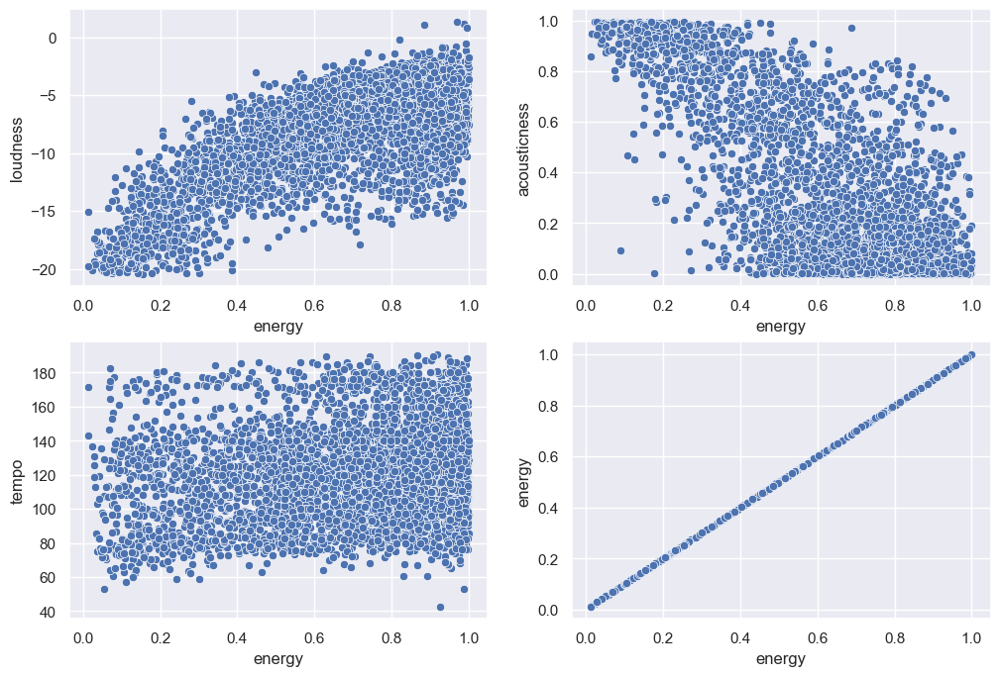

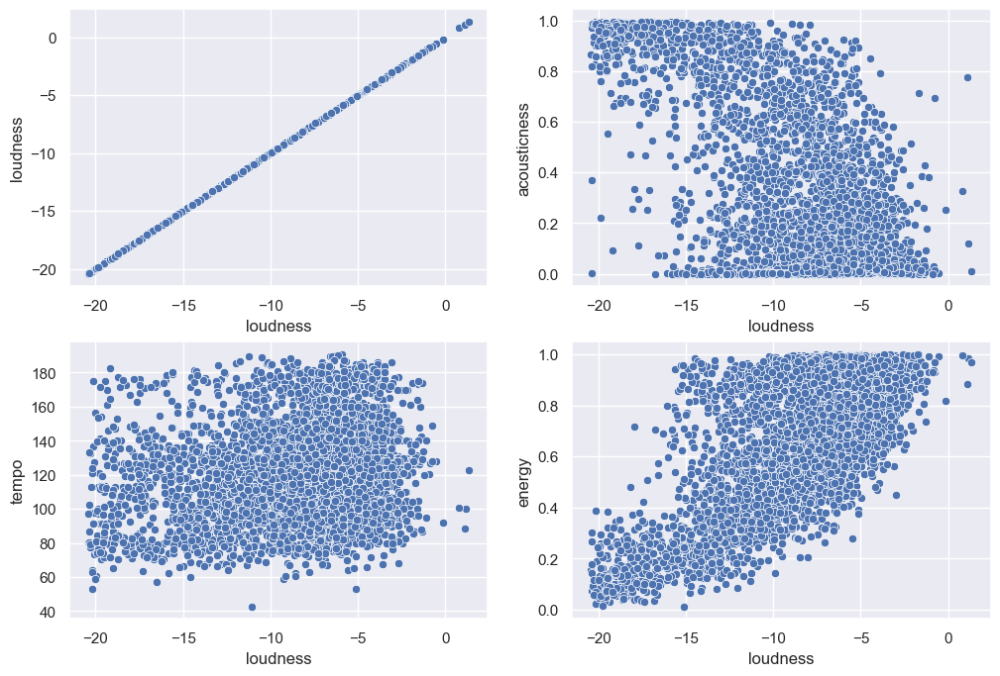

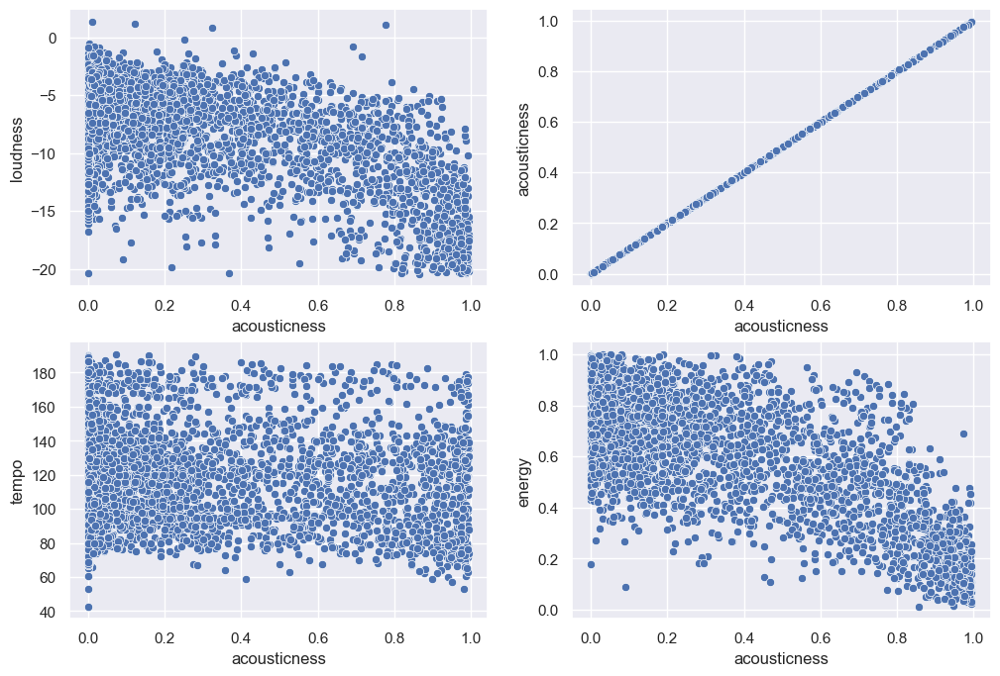

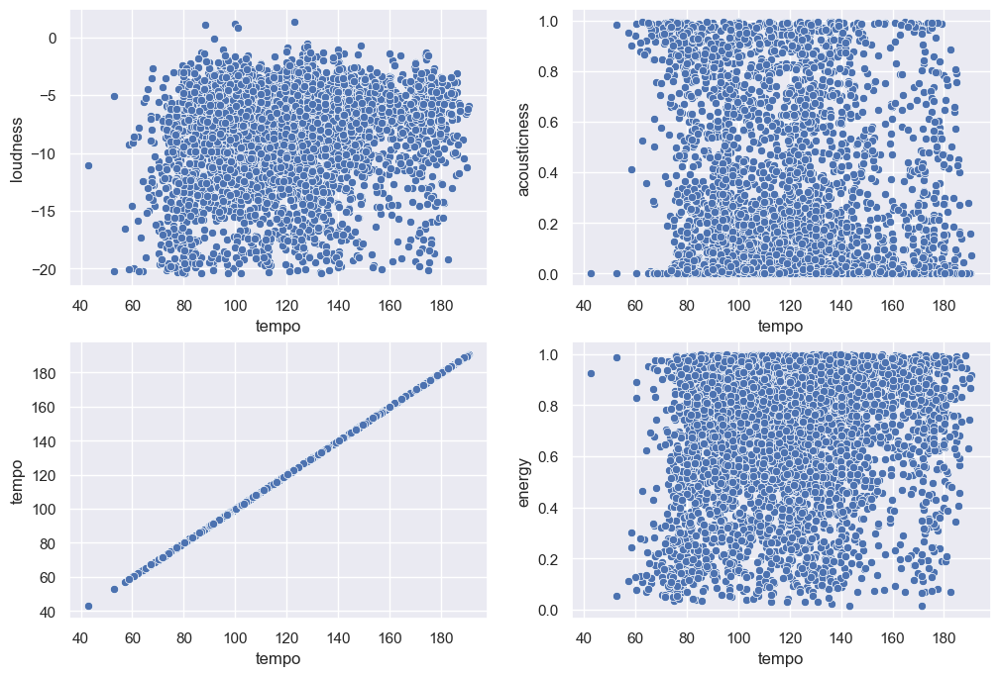

In [42]:
for col in ["energy","loudness","acousticness","tempo"]:
    fig, ax = plt.subplots(2,2,figsize=(12, 8))
    sns.scatterplot(data=songs_c_df, x=col, y='loudness',ax=ax[0,0])
    sns.scatterplot(data=songs_c_df, x=col, y='acousticness',ax=ax[0,1])
    sns.scatterplot(data=songs_c_df, x=col, y="tempo",ax=ax[1,0])
    sns.scatterplot(data=songs_c_df, x=col, y="energy",ax=ax[1,1])
    plt.show()

## Static functions defintion

In [43]:
# a Bussines need ,keep the size of all the playlists at between 50 and 250 songs.
MIN_SAMPLE_P_CLUSTER = 50
MAX_SAMPLE_P_CLUSTER = 250

In [44]:
def get_kval_range(df):
    num_samples = df.shape[0]
    min_k = round(num_samples/MAX_SAMPLE_P_CLUSTER)
    max_k = round(num_samples/MIN_SAMPLE_P_CLUSTER)
    return(min_k,max_k)

In [70]:
from sklearn import preprocessing,cluster
from sklearn.metrics import silhouette_score,silhouette_samples,pairwise_distances
import numpy as np

def run_kmean_allscalers(df,k_value,scale,draw=False,nearst_ith=0):
    iner = None
    sil = None
    closest=None
    scalers = {
        "StandardScaler"      : preprocessing.StandardScaler(),
        "MinMaxScaler"        : preprocessing.MinMaxScaler(),
        "RobustScaler"        : preprocessing.RobustScaler(),
        "QuantileTransformer" : preprocessing.QuantileTransformer(n_quantiles=df.shape[0]),
        "PowerTransformer"    : preprocessing.PowerTransformer()
    }
    
    if scale in scalers:
        my_scaler = scalers[scale].set_output(transform='pandas')
        scaled_df = my_scaler.fit_transform(df)
        my_model = cluster.KMeans(n_clusters=k_value,n_init=10, random_state=123)
        my_model.fit(scaled_df)
        
        labels = my_model.labels_
        centroids  = my_model.cluster_centers_ 
    
        silhouette_avg = silhouette_score(scaled_df, labels)
        P
        sample_sil_val = silhouette_samples(scaled_df, labels)
        
        iner = round(my_model.inertia_,5)
        sil = round(silhouette_avg,5)
        
        songs_df["clus_"+scale] = my_model.predict(scaled_df)
        if nearst_ith != 0:
            distances = pairwise_distances(centroids, scaled_df, metric='euclidean')
            ind = [np.argpartition(i, 20)[:20] for i in distances]
            closest = [scaled_df[indexes] for indexes in ind]

        if draw:
            fig,axis = plt.subplots(1, 1)
            fig.set_size_inches(20, 10)
            y_lower = 10
            for i in range(k_value): 
                ith_cluster_sv = sample_sil_val[labels == i]
                #print(f"\t- For cluster = {i} the silhouette value is: {round(np.mean(ith_cluster_sv),2)}")
                
                ith_cluster_sv.sort()
                # Calculate where to put the silhuette on the y axes
                ith_cluster_size = ith_cluster_sv.shape[0]
                y_upper = y_lower + ith_cluster_size

                axis.axvline(x=silhouette_avg, color="red", linestyle="--")
                # Paint the cluster
                axis.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_sv, alpha = 0.7)
                # Label the cluster
                axis.text(-0.05, y_lower + 0.5 * ith_cluster_size, str(i))
                
                # Calculate the next y lower value for the next cluster of the graph
                y_lower = y_upper + 10 # we left 10 spaces without any observation
                
            axis.set_title("Silhouette score for k = %s"%str(k_value))
            axis.set_xlabel("S(i)")
            axis.set_ylabel("Cluster ID")
        
    else:
        print("wrong scale value given! ")

    return [iner,sil,closest]

In [46]:
def draw_3styled_vlines(xvals,ymin,ymax):
    plt.vlines(x=xvals[0],ymin=ymin,ymax=ymax,colors="green", linestyles='dashed',label='Kvalue_1',alpha = 0.5)
    plt.vlines(x=xvals[1],ymin=ymin,ymax=ymax,colors="grey", linestyles='dashed',label='Kvalue_2',alpha = 0.5)
    plt.vlines(x=xvals[2],ymin=ymin,ymax=ymax,colors="blue", linestyles='dashed',label='Kvalue_3',alpha = 0.5)
    plt.legend()

## Choose K Value Range

In [47]:
(k_min,k_max) = get_kval_range(songs_c_df) 
(k_min,k_max)


(19, 97)

In [48]:
#TODO: to speed up calculations
k_max=60
(k_min,k_max)

(19, 60)

### Use MinMaxScaler

C:\Users\Jacqueline\AppData\Local\Temp\ipykernel_19928\1503869378.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,axis = plt.subplots(1, 1)


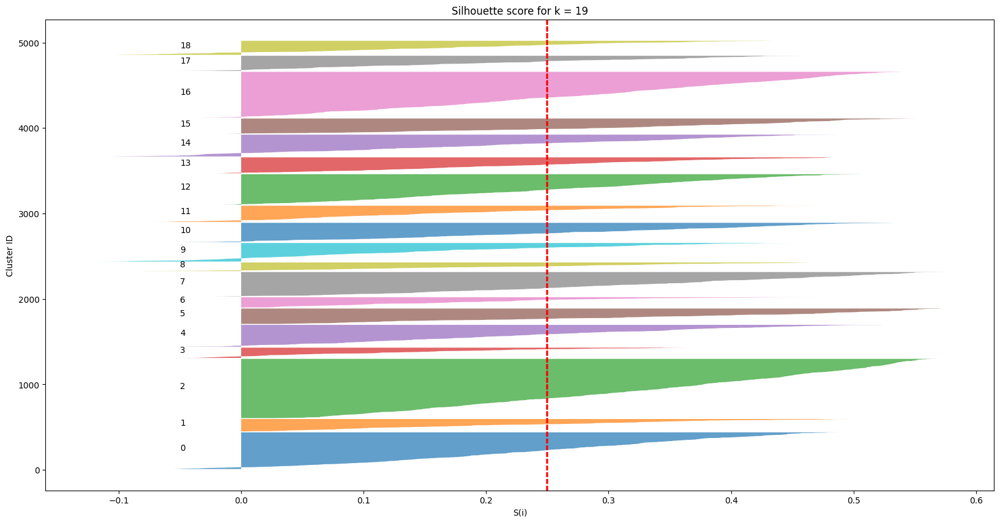

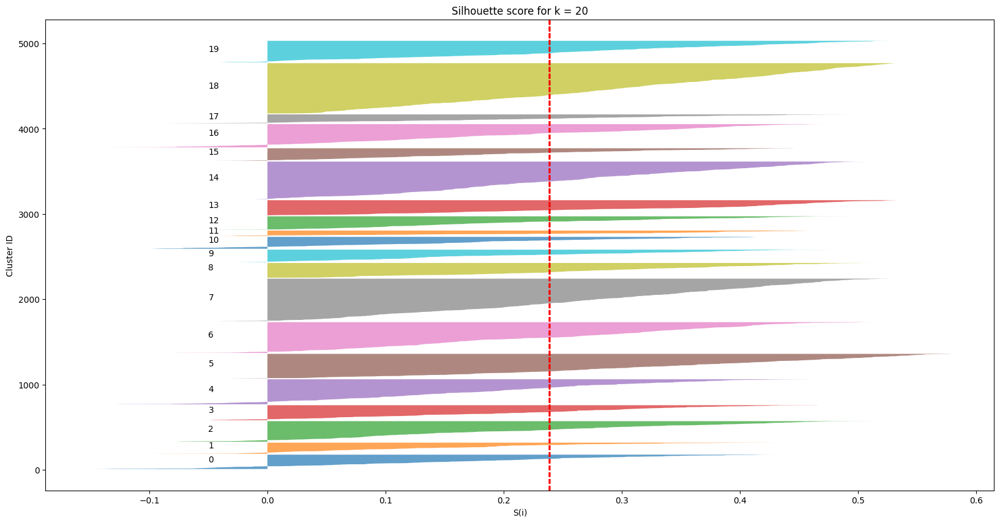

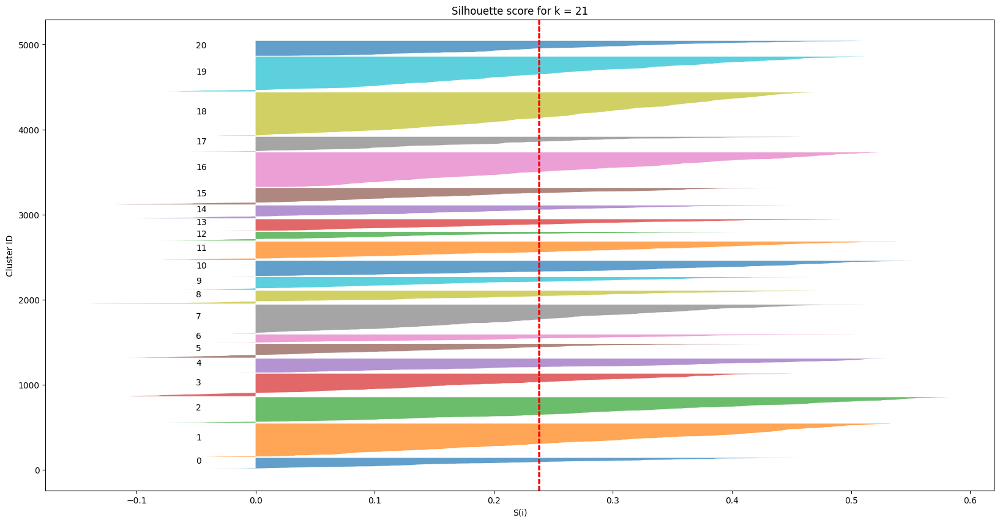

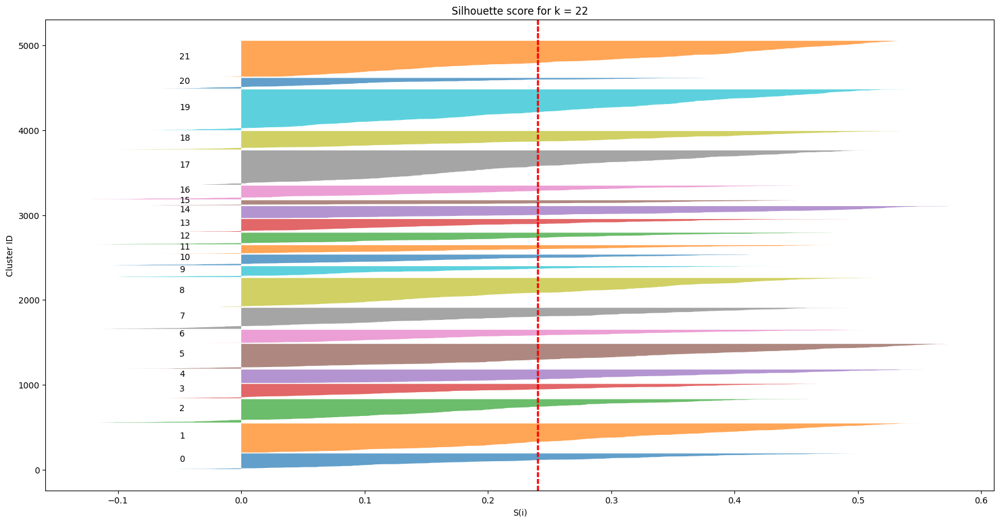

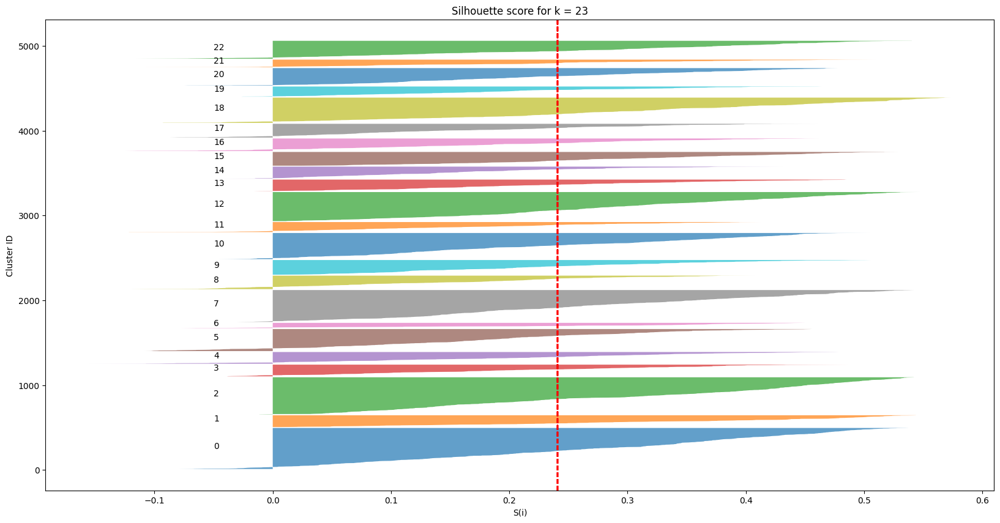

...

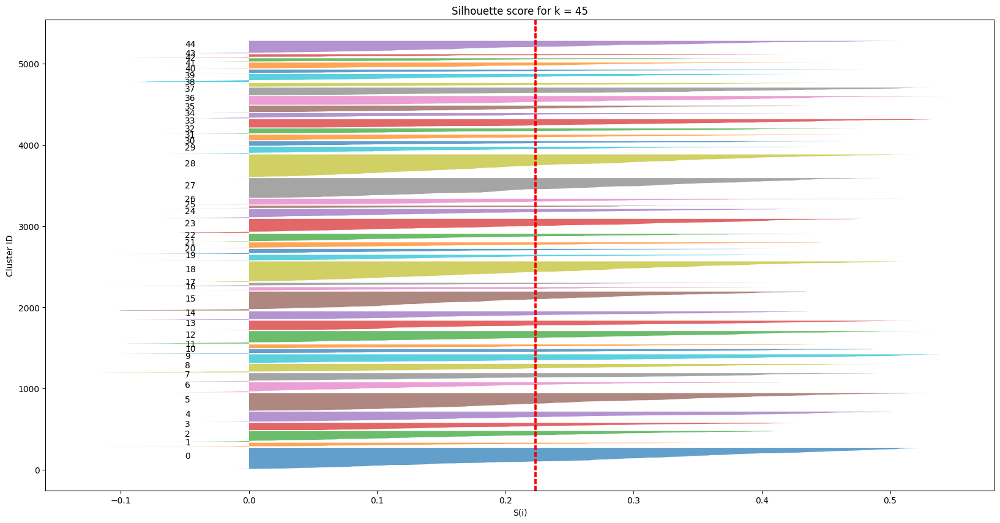

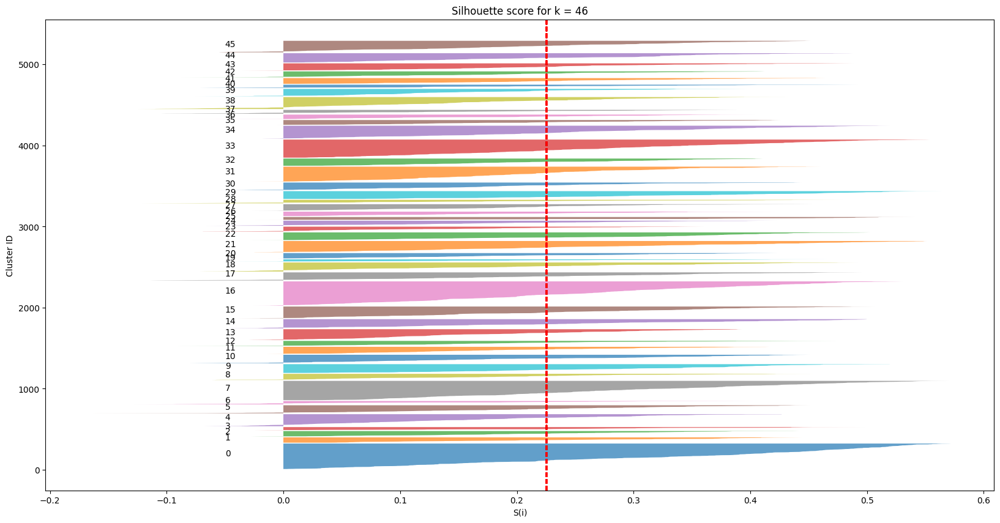

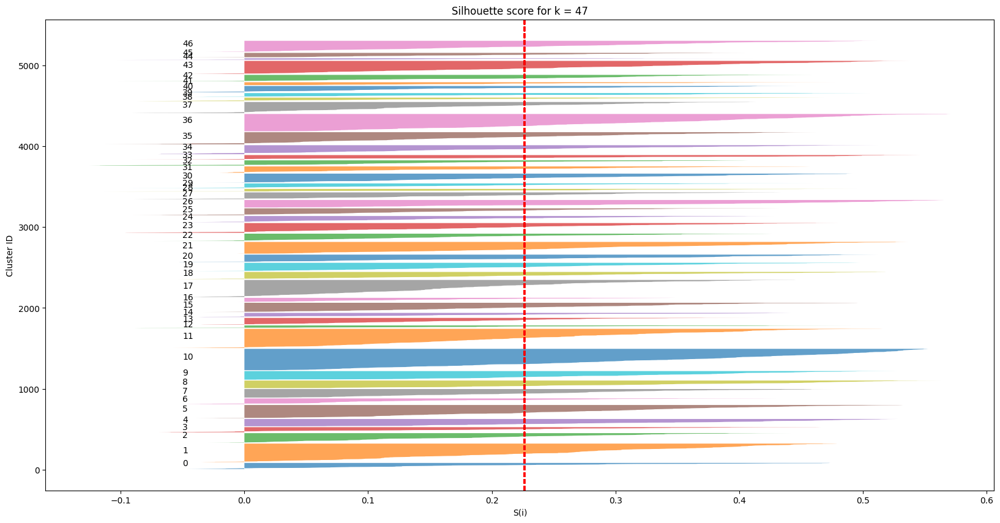

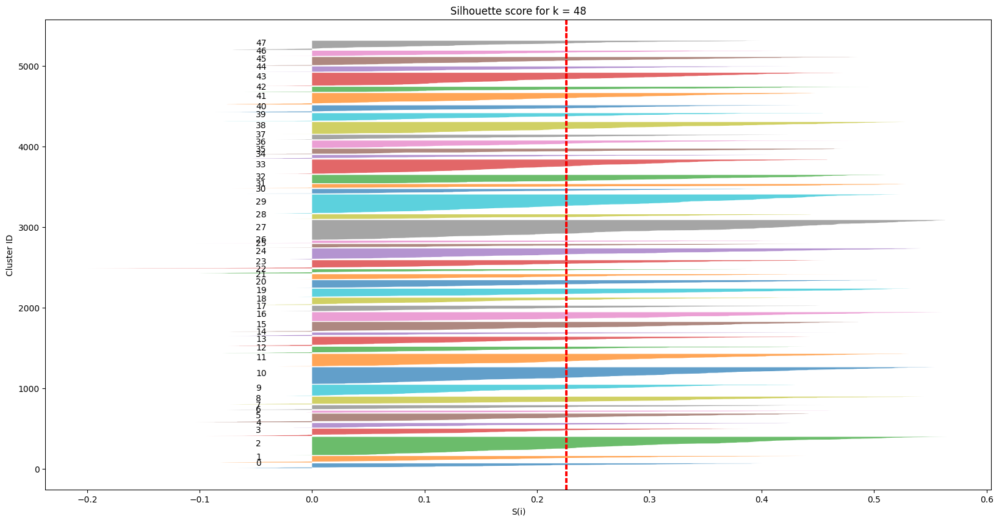

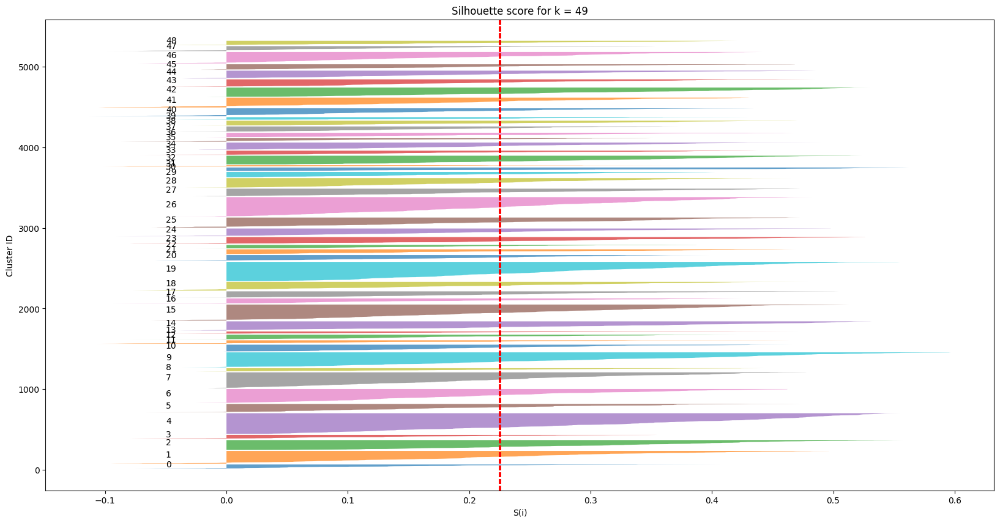

In [19]:
scaling = "MinMaxScaler"
diff_k_inertia_l = []
diff_k_sil_score_l = []

for k_val in range(k_min,k_max):
    kmean_result = run_kmean_allscalers(songs_c_df,k_val,scaling)
    diff_k_inertia_l.append(kmean_result[0])
    diff_k_sil_score_l.append(kmean_result[1])

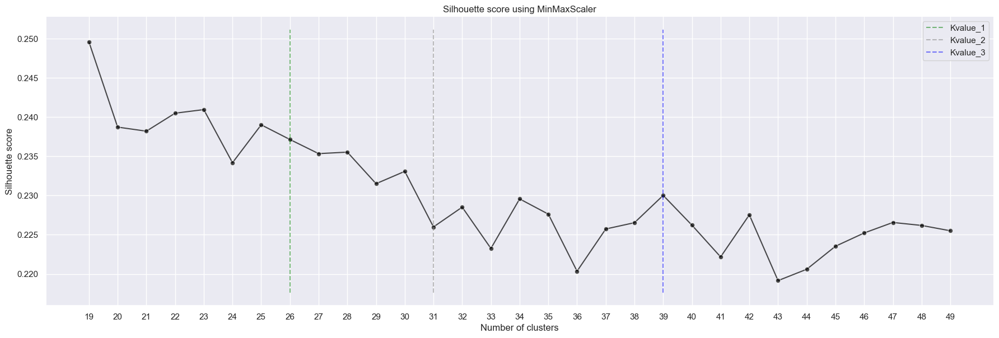

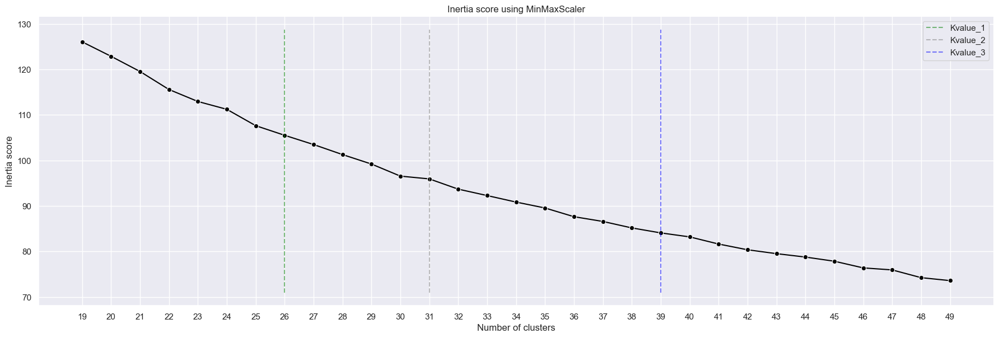

In [20]:
opt_k_vals = [26,31,39]

sns.set_theme(style='darkgrid', color_codes=True)

# Draw Silhouette score
plot= (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_sil_score_l,marker='o',height=6,aspect=3,color="black",alpha = 0.7)
    .set(title=f"Silhouette score using {scaling}")
    .set_axis_labels("Number of clusters", "Silhouette score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)


# Draw Inertia score
plot= (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_inertia_l,marker='o',height=6,aspect=3,color="black")
    .set(title=f"Inertia score using {scaling}")
    .set(xlabel="Number of clusters")
    .set(ylabel="Inertia score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)


plt.show()

### Use StanderdScaler

In [55]:
scaling = "StandardScaler"
diff_k_inertia_l = []
diff_k_sil_score_l = []

for k_val in range(2,k_max):
    kmean_result = run_kmean_allscalers(songs_c_df,k_val,scaling)
    diff_k_inertia_l.append(kmean_result[0])
    diff_k_sil_score_l.append(kmean_result[1])

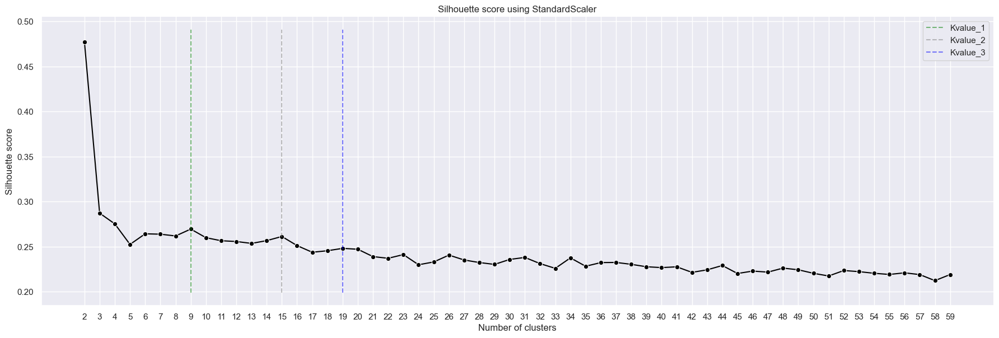

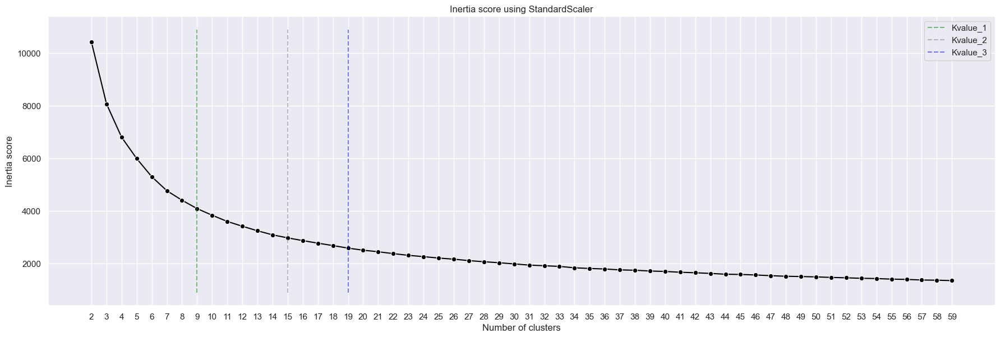

In [57]:
opt_k_vals = [9,15,19]
sns.set_theme(style='darkgrid', color_codes=True)

# Draw Silhouette score
plot = (
    sns.relplot(kind="line",x=range(2,k_max),y=diff_k_sil_score_l,marker='o',height=6,aspect=3,color="black")
    .set(title=f"Silhouette score using {scaling}")
    .set_axis_labels("Number of clusters", "Silhouette score")
    .set(xticks=range(2,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)


# Draw Inertia score
plot = (
    sns.relplot(kind="line",x=range(2,k_max),y=diff_k_inertia_l,marker='o',height=6,aspect=3,color="black")
    .set(title=f"Inertia score using {scaling}")
    .set(xlabel="Number of clusters")
    .set(ylabel="Inertia score")
    .set(xticks=range(2,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)

plt.show()

### Use RobustScaler

C:\Users\Jacqueline\AppData\Local\Temp\ipykernel_19928\1503869378.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,axis = plt.subplots(1, 1)


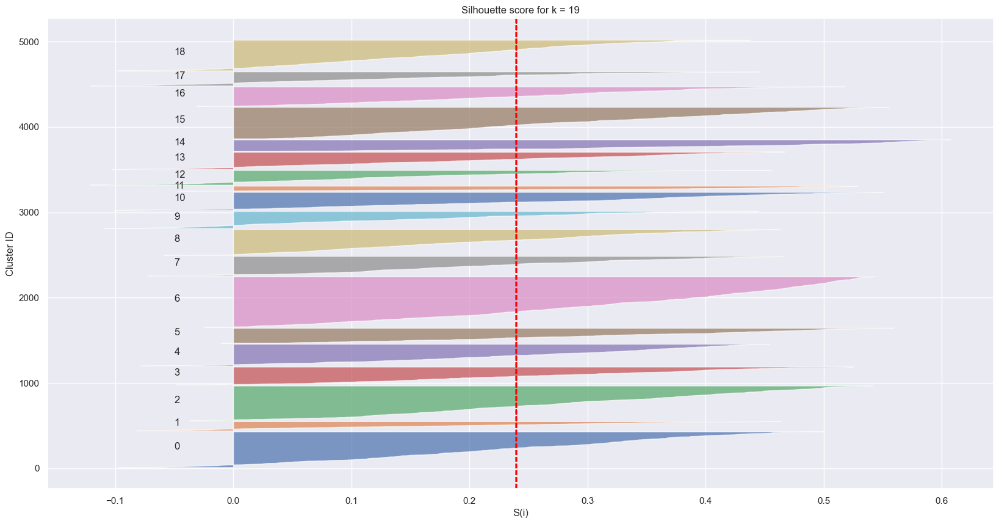

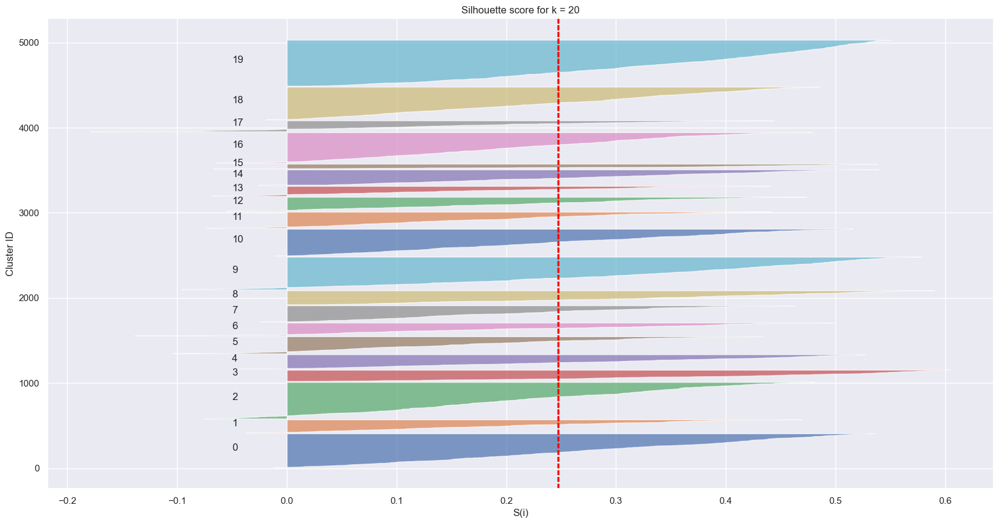

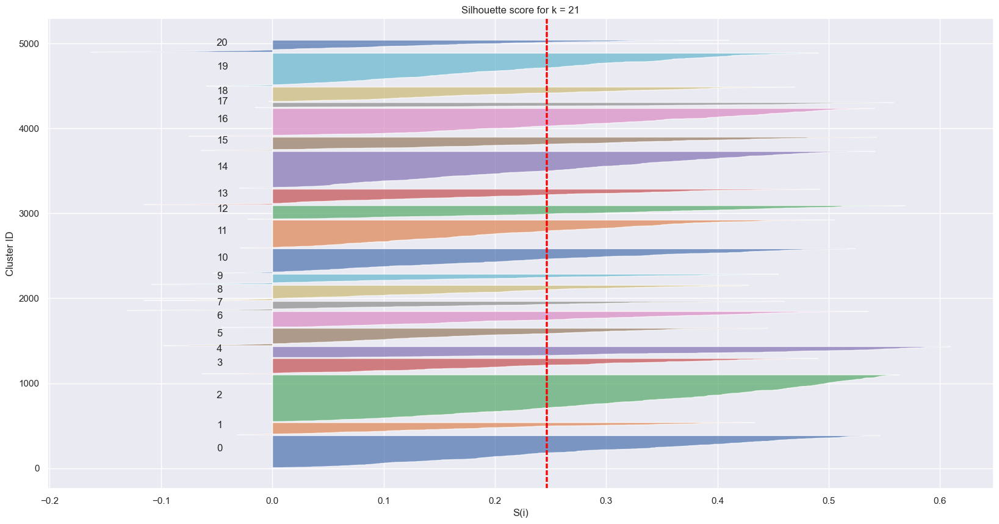

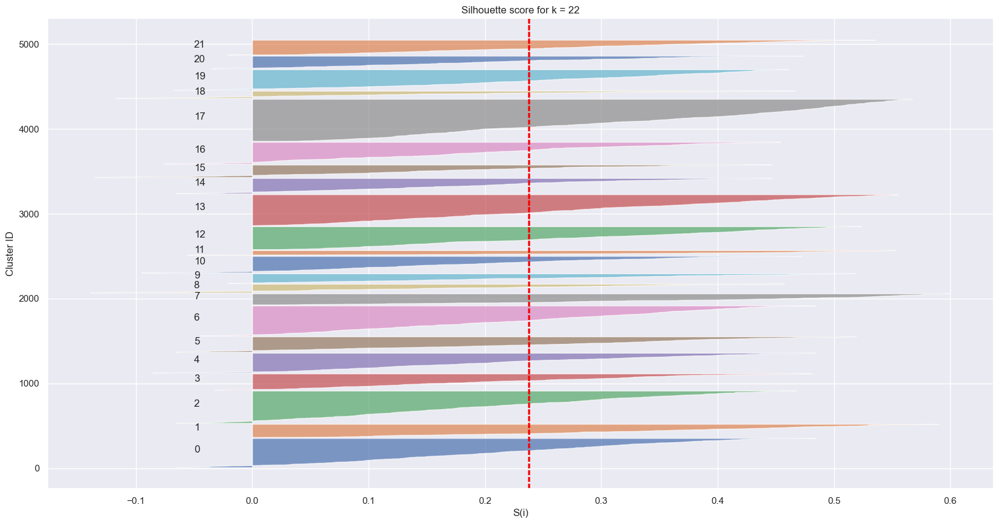

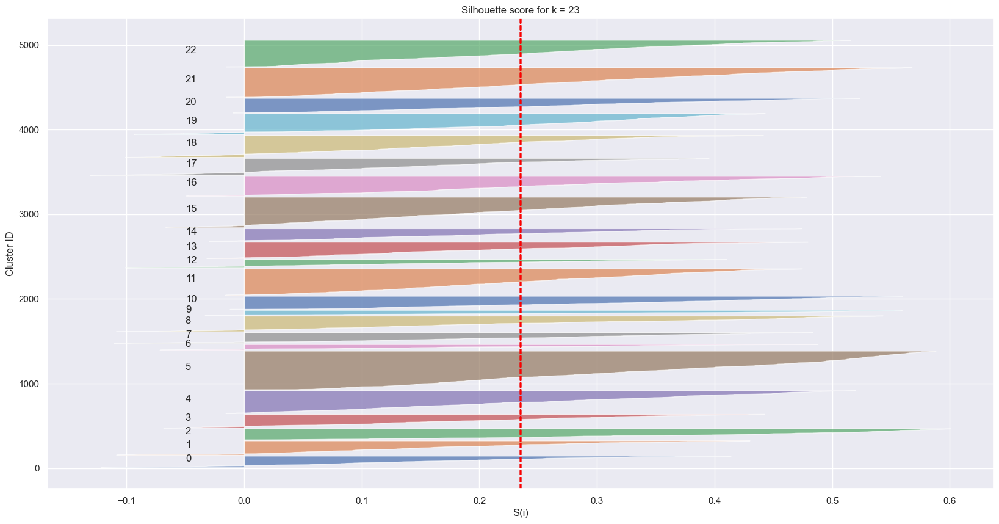

...

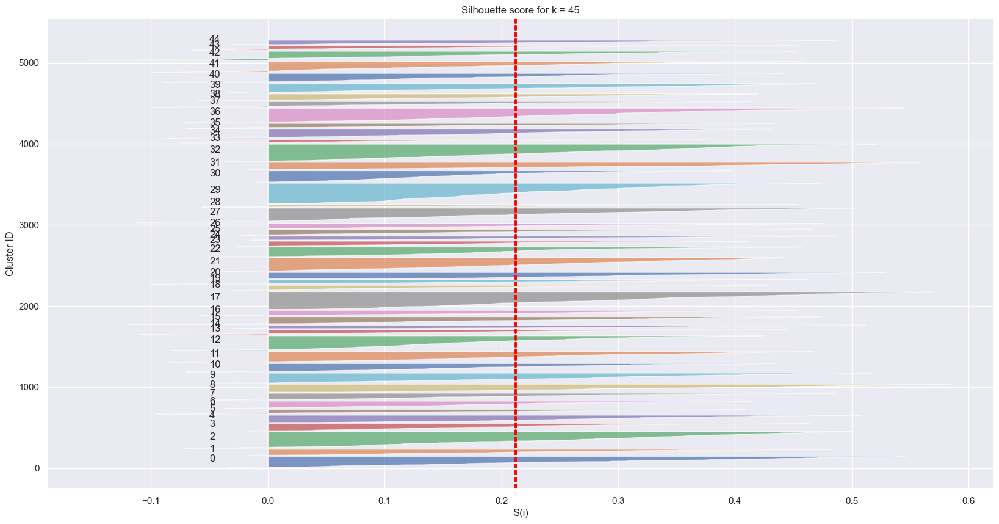

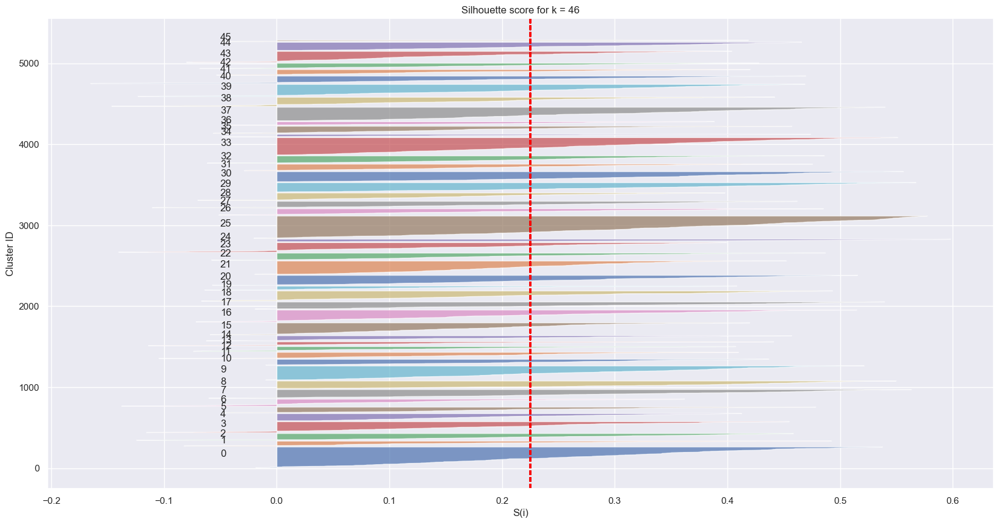

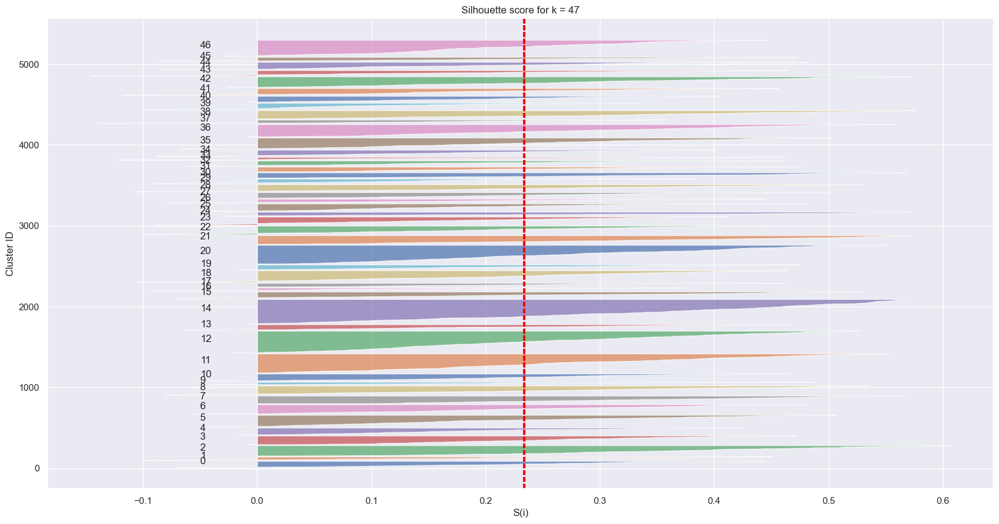

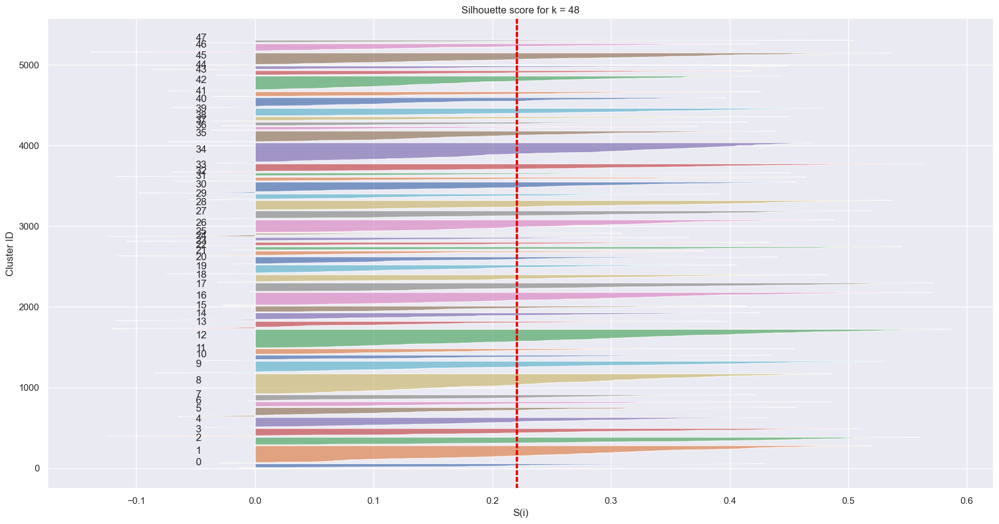

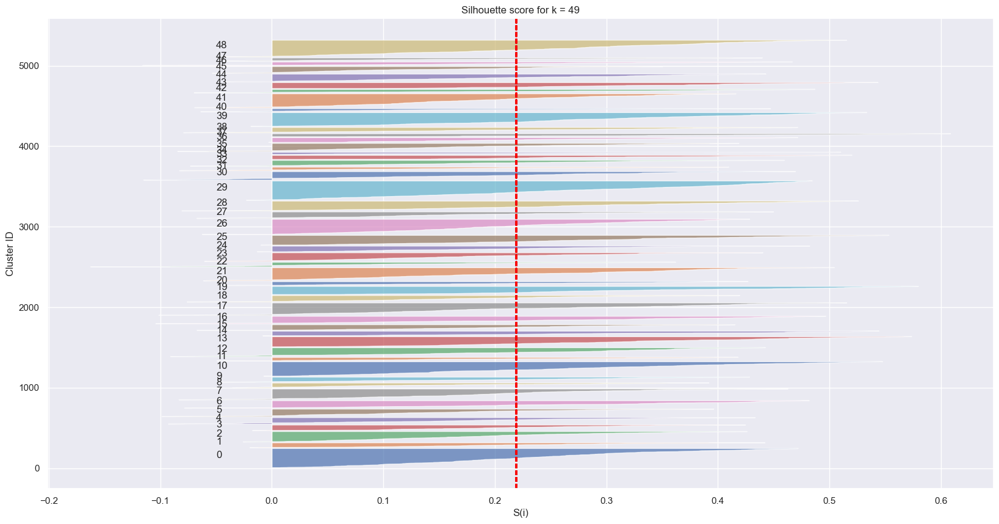

In [23]:
scaling = "RobustScaler"
diff_k_inertia_l = []
diff_k_sil_score_l = []

for k_val in range(k_min,k_max):
    kmean_result = run_kmean_allscalers(songs_c_df,k_val,scaling)
    diff_k_inertia_l.append(kmean_result[0])
    diff_k_sil_score_l.append(kmean_result[1])

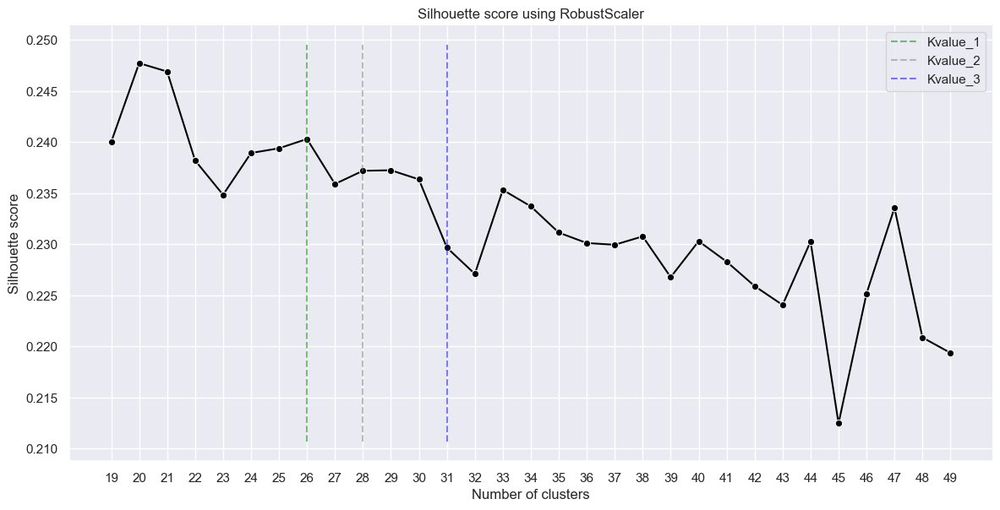

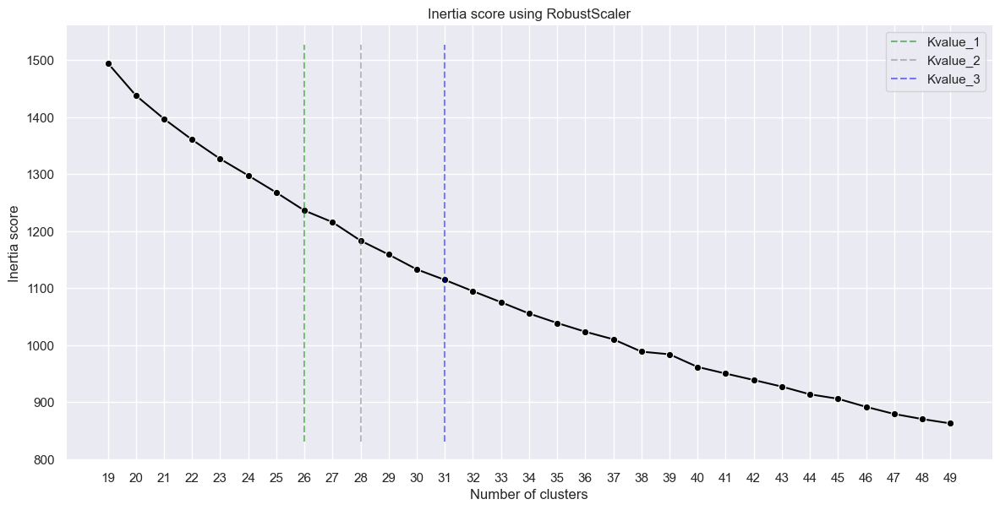

In [24]:
opt_k_vals = [26,28,31]

sns.set_theme(style='darkgrid', color_codes=True)

# Draw Silhouette score
plot = (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_sil_score_l,marker='o',height=6,aspect=2,color="black")
    .set(title=f"Silhouette score using {scaling}")
    .set_axis_labels("Number of clusters", "Silhouette score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)



# Draw Inertia score
plot = (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_inertia_l,marker='o',height=6,aspect=2,color="black")
    .set(title=f"Inertia score using {scaling}")
    .set(xlabel="Number of clusters")
    .set(ylabel="Inertia score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)



plt.show()

### Use QuantileTransformer

C:\Users\Jacqueline\AppData\Local\Temp\ipykernel_19928\1503869378.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,axis = plt.subplots(1, 1)


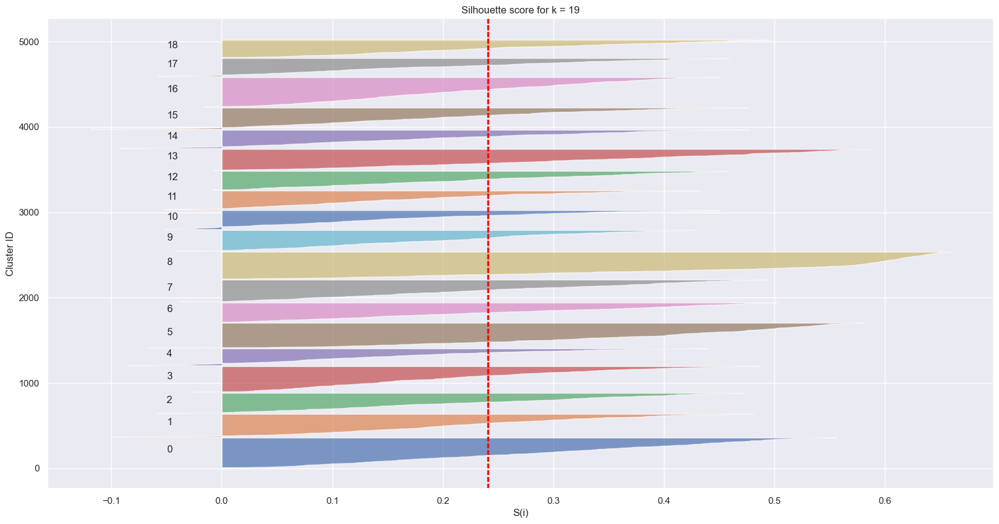

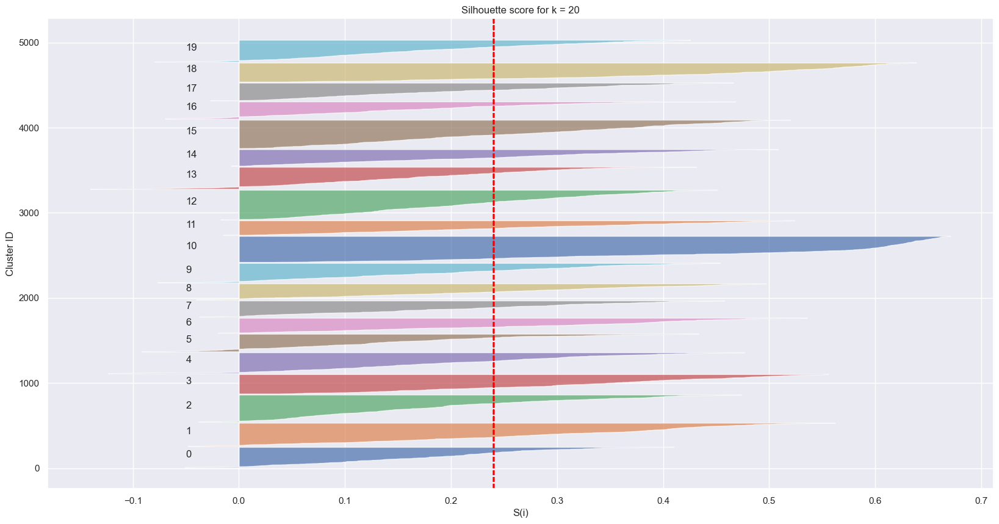

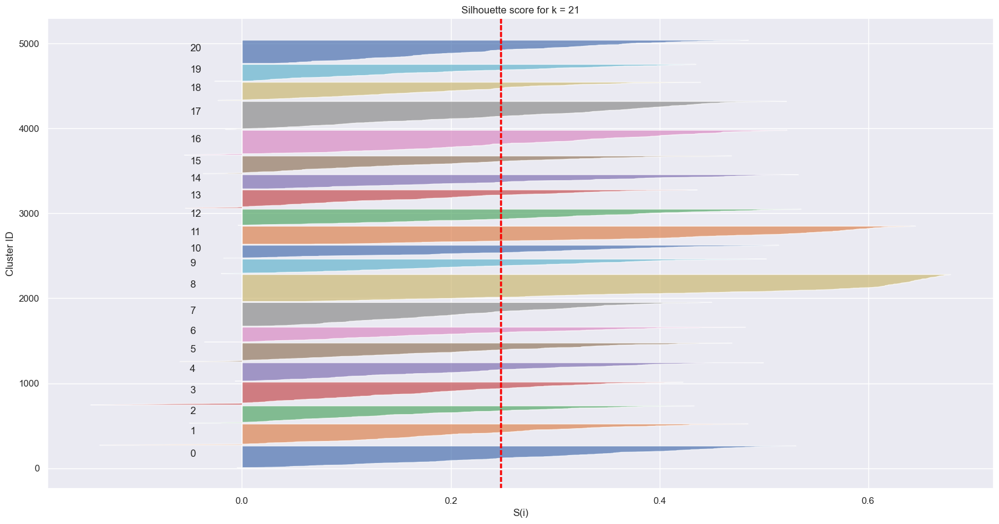

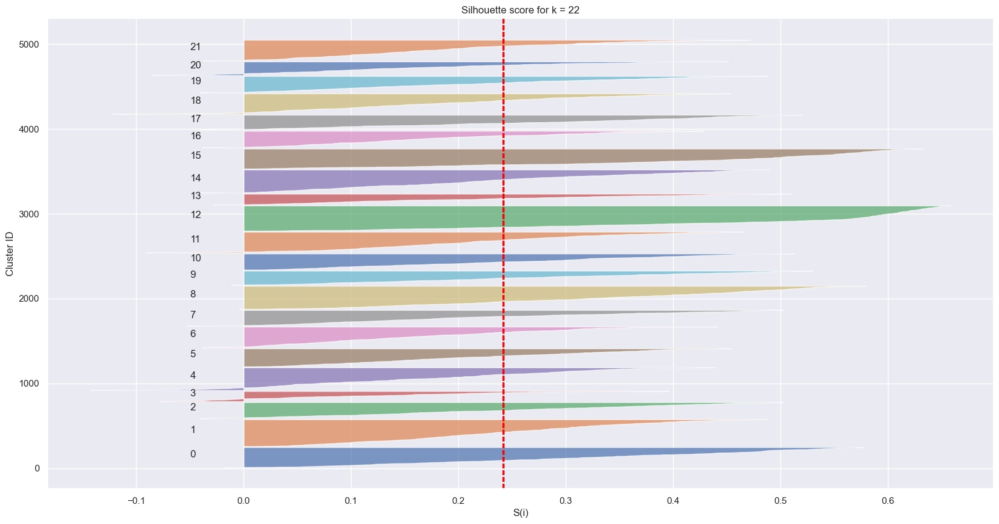

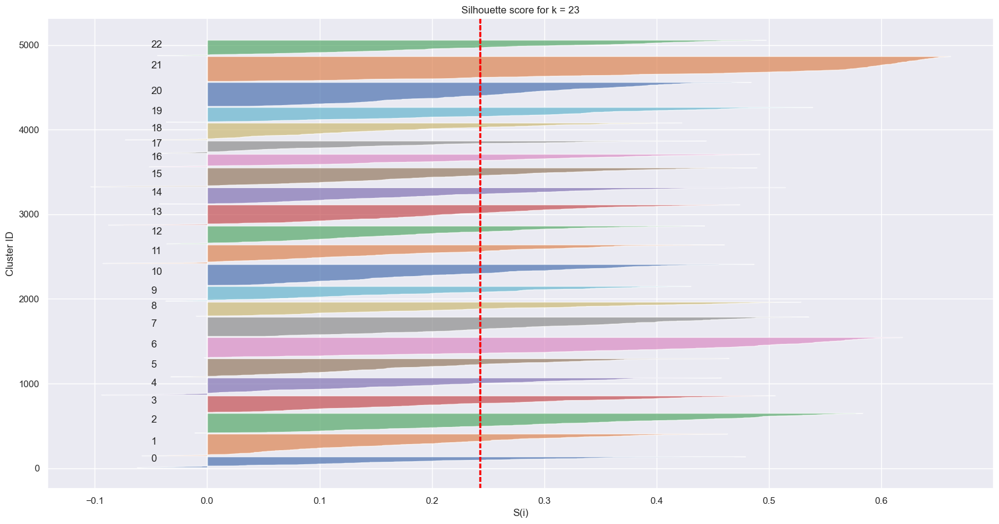

...

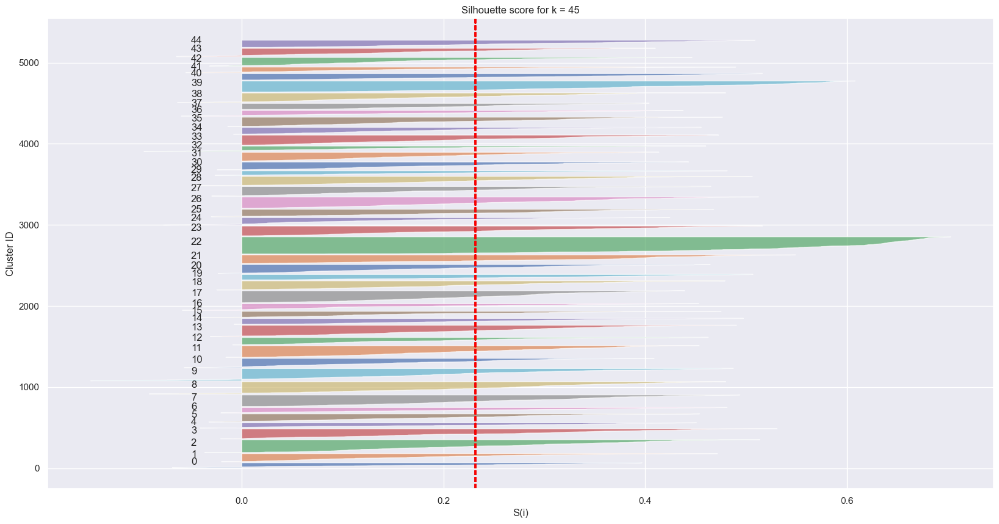

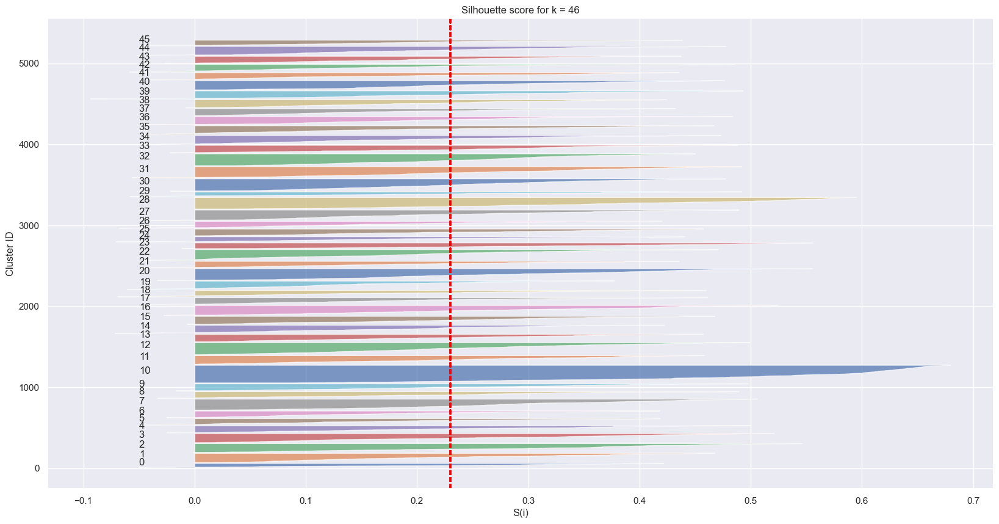

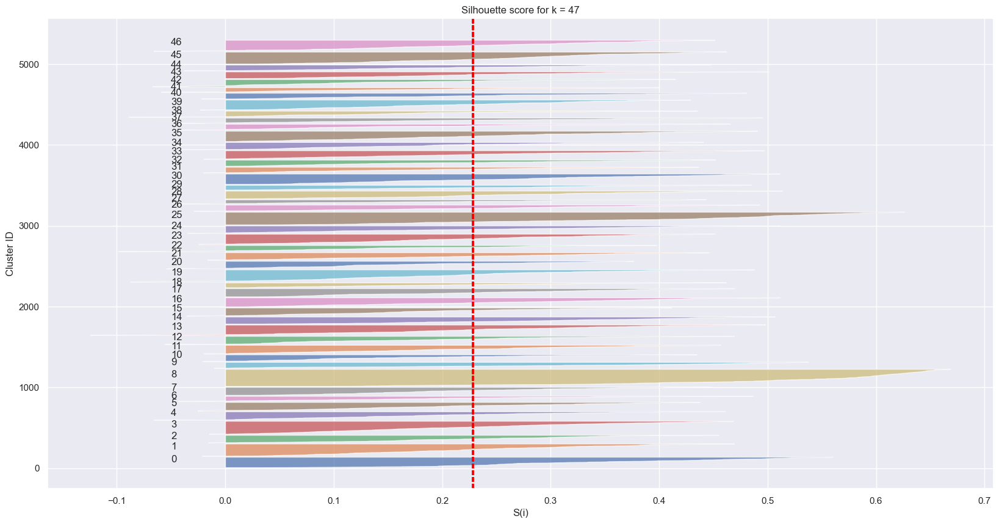

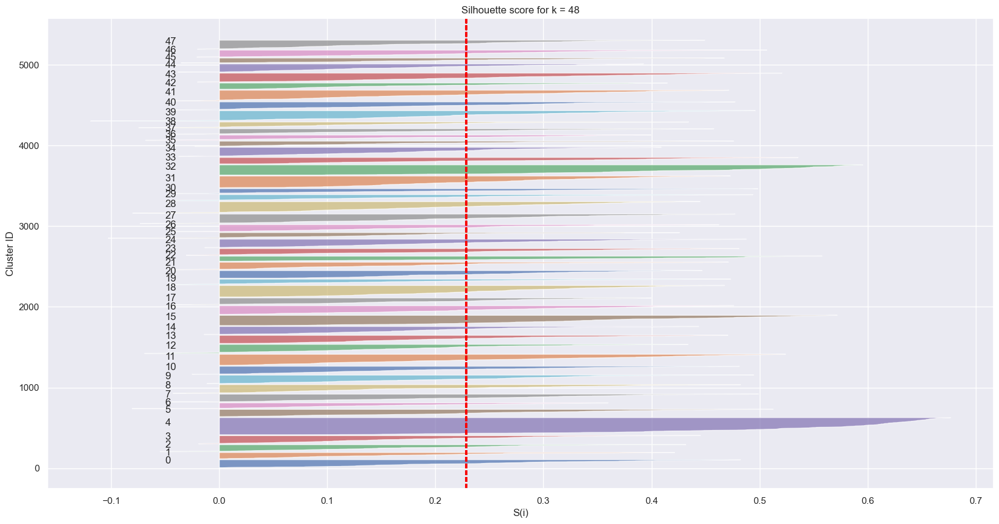

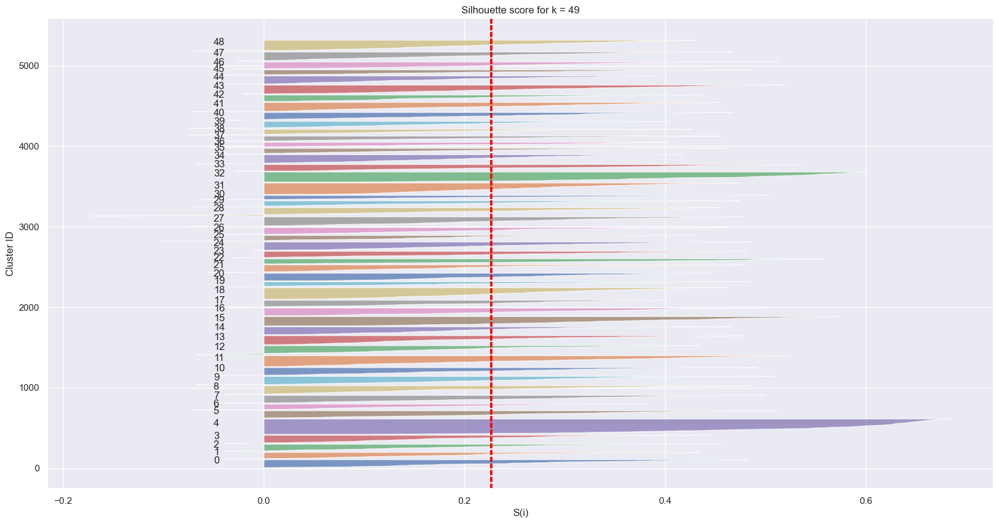

In [25]:
scaling = "QuantileTransformer"
diff_k_inertia_l = []
diff_k_sil_score_l = []

for k_val in range(k_min,k_max):
    kmean_result = run_kmean_allscalers(songs_c_df,k_val,scaling)
    diff_k_inertia_l.append(kmean_result[0])
    diff_k_sil_score_l.append(kmean_result[1])

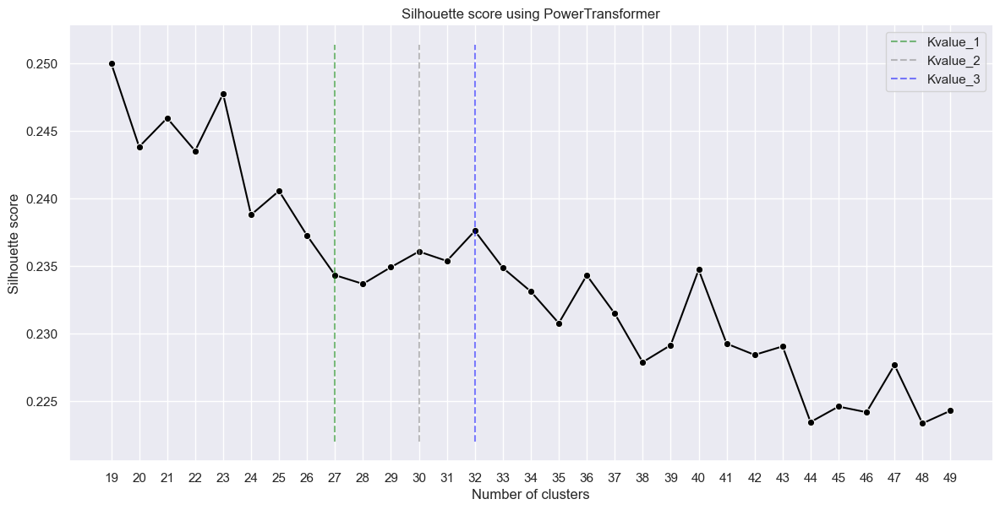

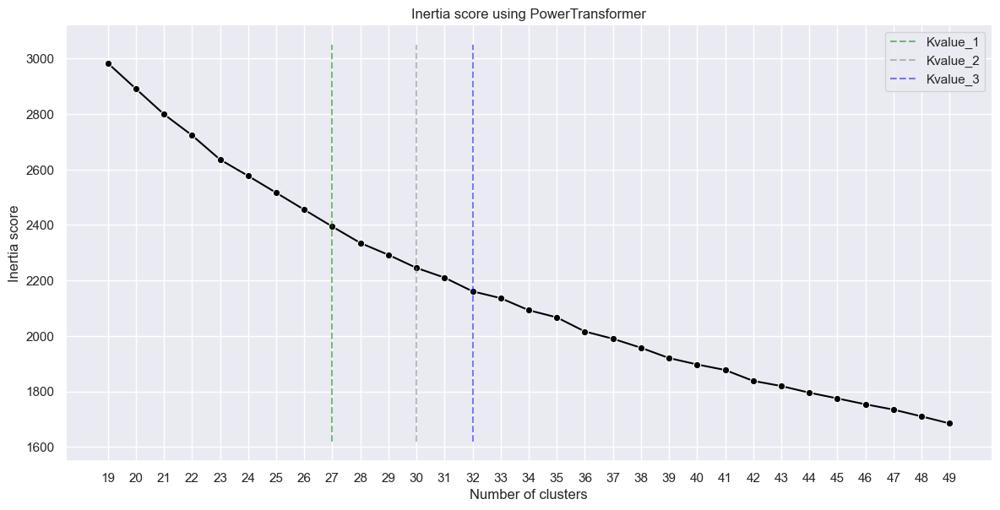

In [30]:
opt_k_vals = [27,30,32]

sns.set_theme(style='darkgrid', color_codes=True)

# Draw Silhouette score
plot = (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_sil_score_l,marker='o',height=6,aspect=2,color="black")
    .set(title=f"Silhouette score using {scaling}")
    .set_axis_labels("Number of clusters", "Silhouette score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)



# Draw Inertia score
plot = (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_inertia_l,marker='o',height=6,aspect=2,color="black")
    .set(title=f"Inertia score using {scaling}")
    .set(xlabel="Number of clusters")
    .set(ylabel="Inertia score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)



plt.show()

### Use PowerTransformer

C:\Users\Jacqueline\AppData\Local\Temp\ipykernel_19928\1503869378.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,axis = plt.subplots(1, 1)


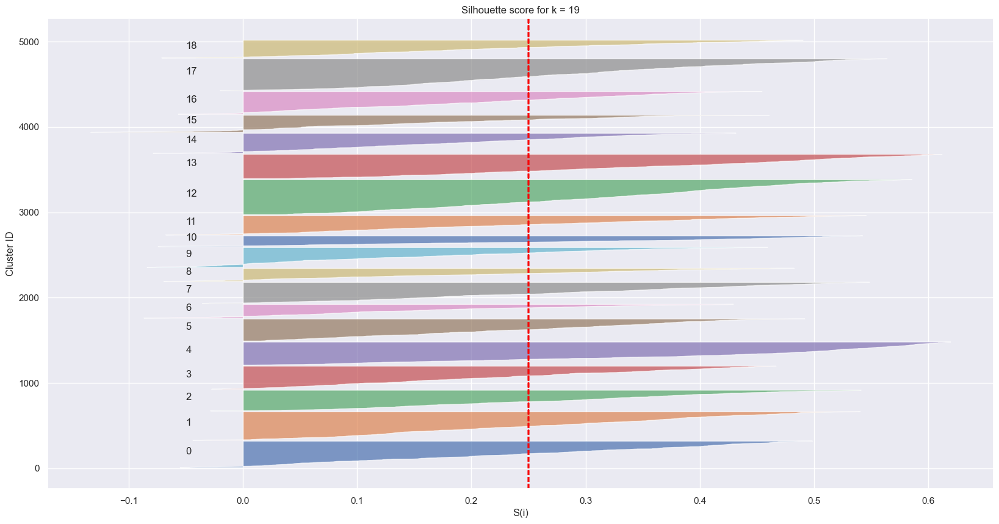

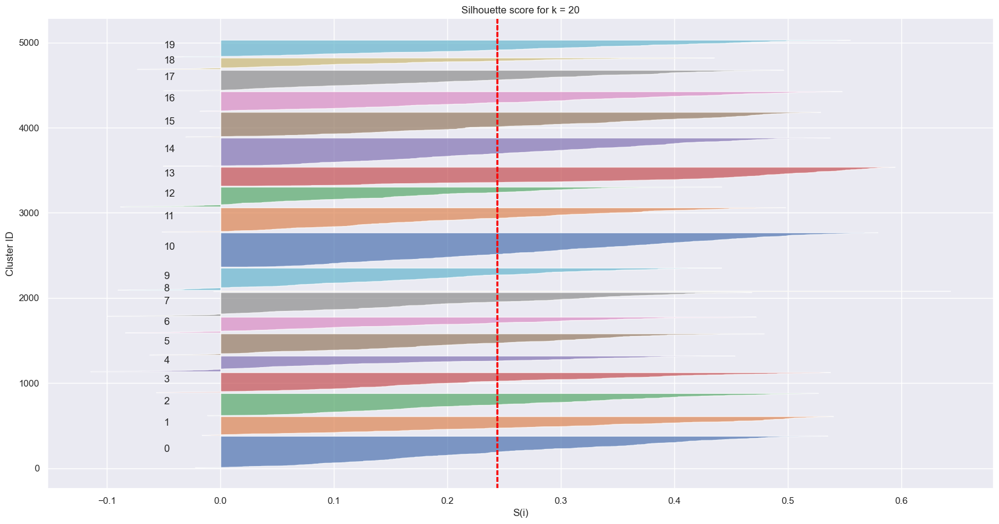

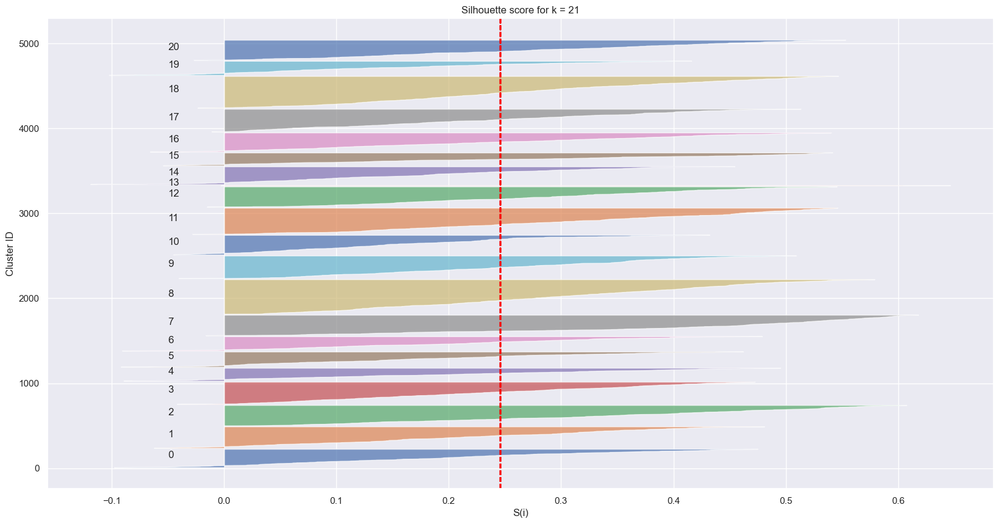

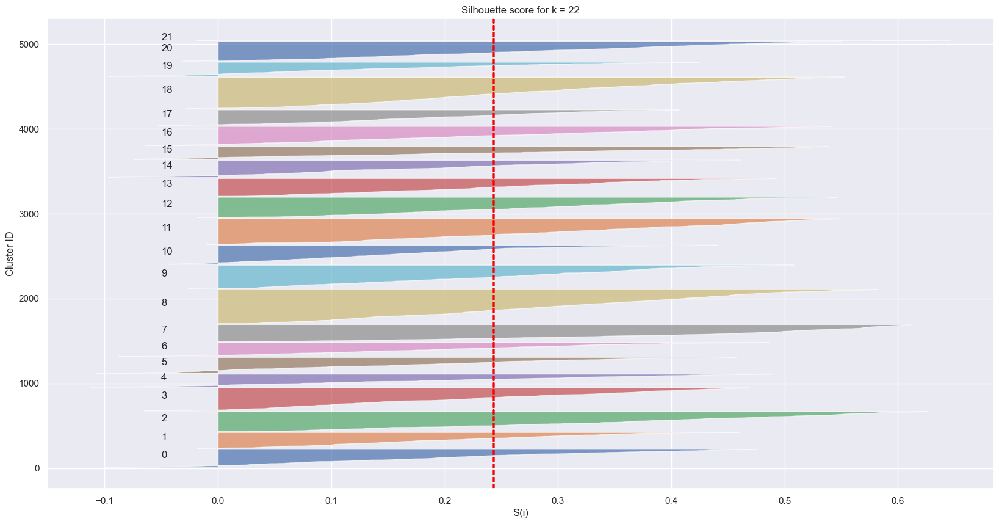

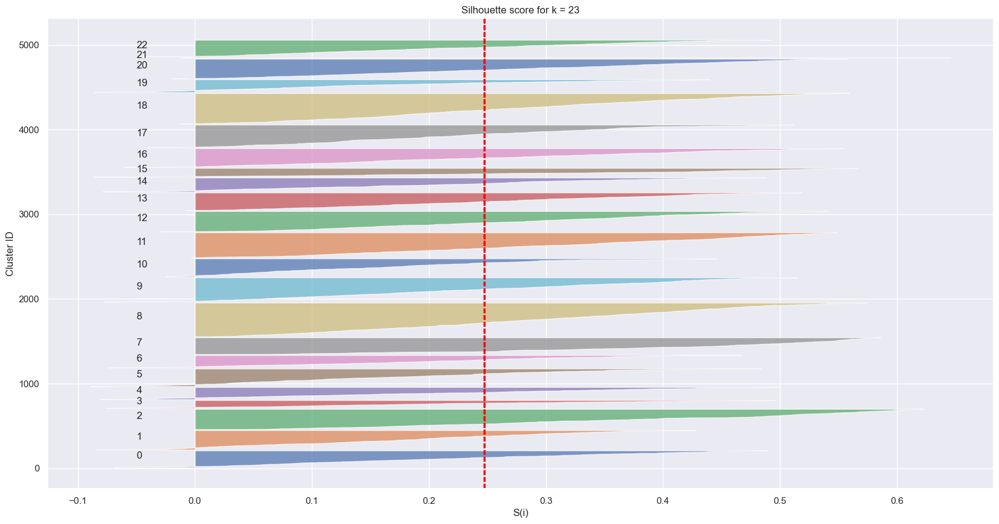

...

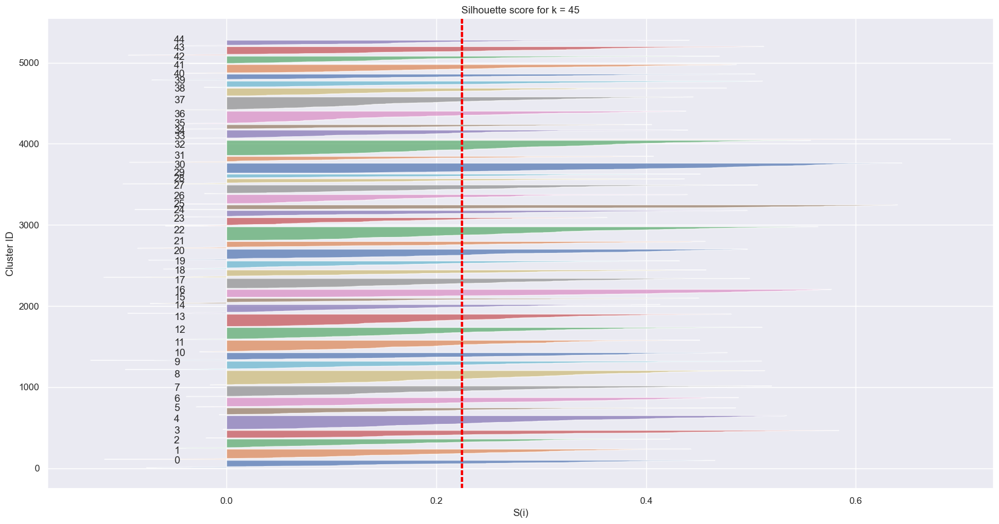

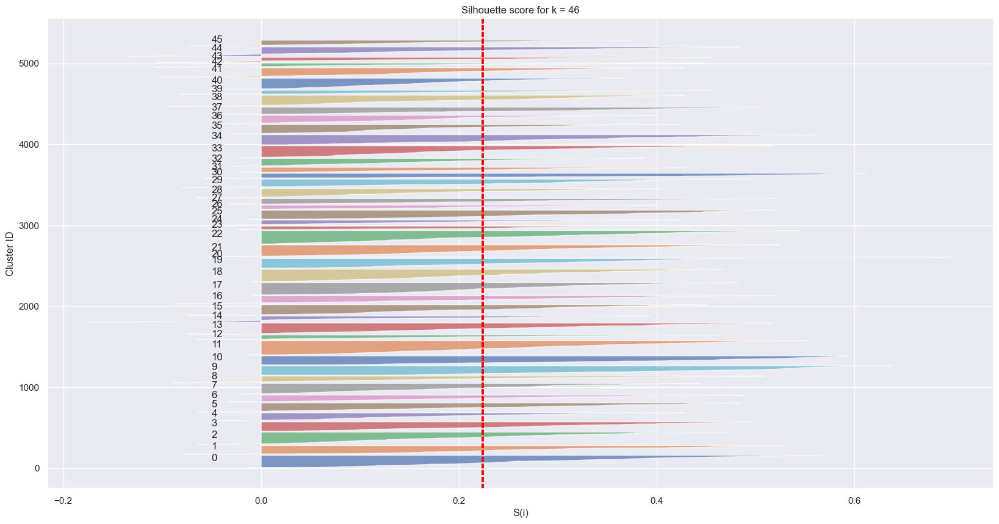

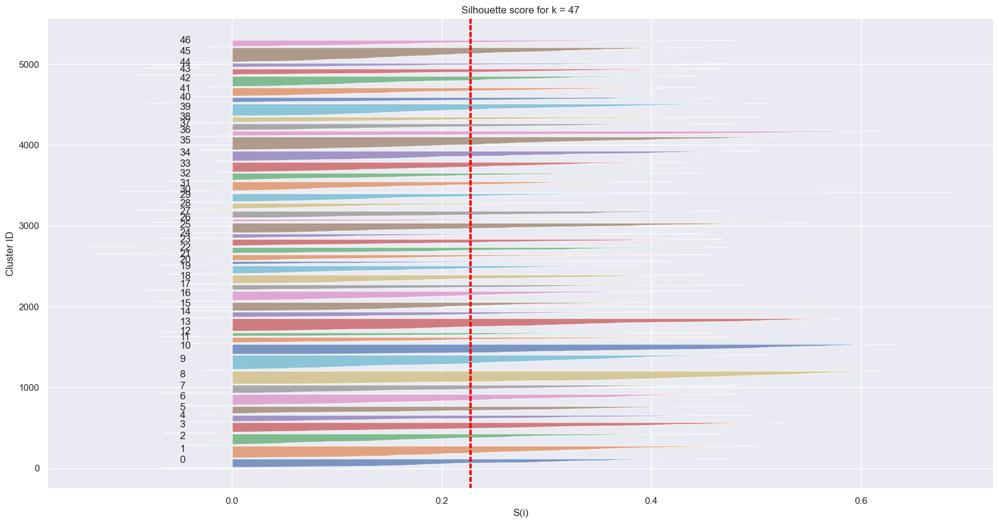

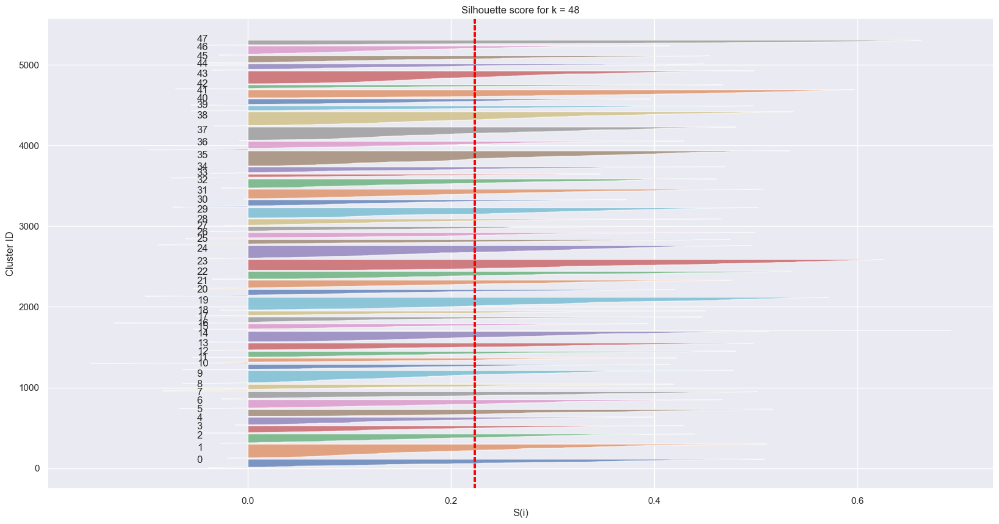

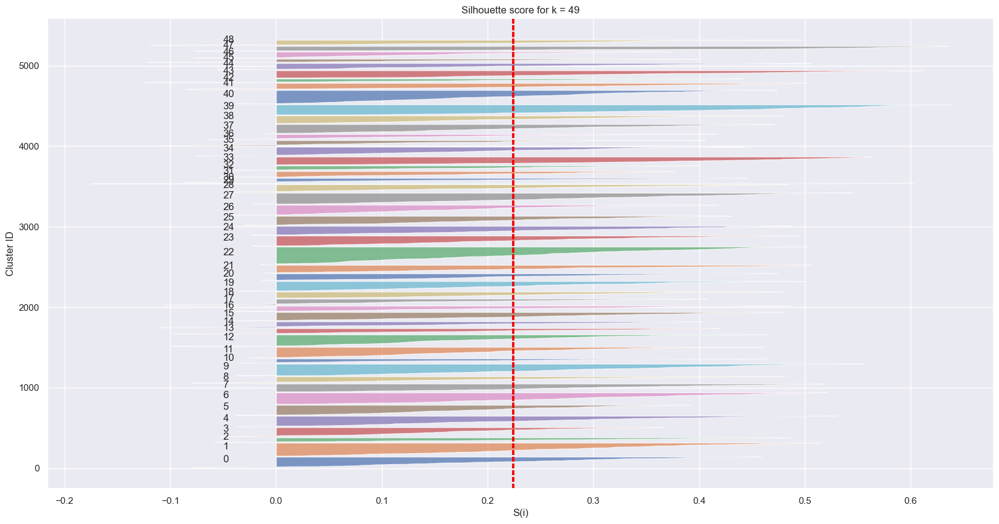

In [27]:
scaling = "PowerTransformer"
diff_k_inertia_l = []
diff_k_sil_score_l = []

for k_val in range(k_min,k_max):
    kmean_result = run_kmean_allscalers(songs_c_df,k_val,scaling)
    diff_k_inertia_l.append(kmean_result[0])
    diff_k_sil_score_l.append(kmean_result[1])

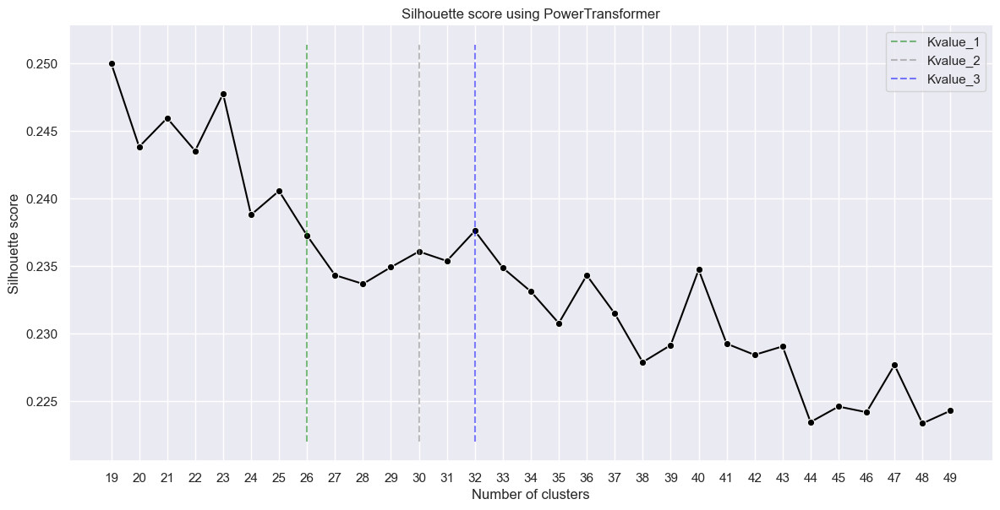

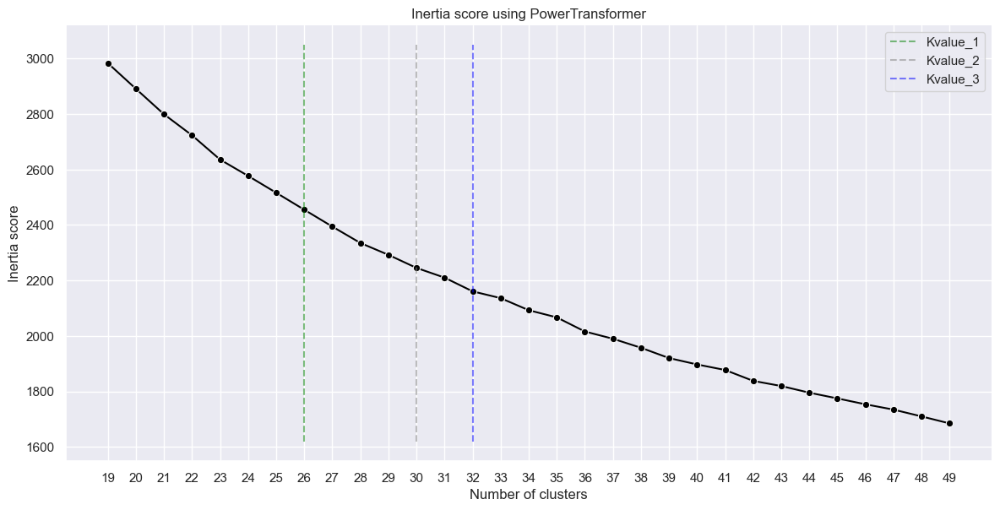

In [28]:
opt_k_vals = [26,30,32]

sns.set_theme(style='darkgrid', color_codes=True)

# Draw Silhouette score
plot = (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_sil_score_l,marker='o',height=6,aspect=2,color="black")
    .set(title=f"Silhouette score using {scaling}")
    .set_axis_labels("Number of clusters", "Silhouette score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)



# Draw Inertia score
plot = (
    sns.relplot(kind="line",x=range(k_min,k_max),y=diff_k_inertia_l,marker='o',height=6,aspect=2,color="black")
    .set(title=f"Inertia score using {scaling}")
    .set(xlabel="Number of clusters")
    .set(ylabel="Inertia score")
    .set(xticks=range(k_min,k_max,1))
)
ymin,ymax = plot.ax.get_ylim()
draw_3styled_vlines(opt_k_vals,ymin,ymax)



plt.show()

### Conclusion

|Scaler               |k_1 |k_2 |k_3 |
|:------------        |:---|:---|:---|
|MinMaxScaler         |26  |31  |39  |
|StandardScaler       |26  |33  |37  |
|RobustScaler         |26  |28  |31  |
|QuantileTransformer  |27  |33  |39  |
|PowerTransformer     |26  |30  |32  |


Fix for StandardScaler
monitor between 24 and 40

## Explore Sil Values for chosen K Value Range

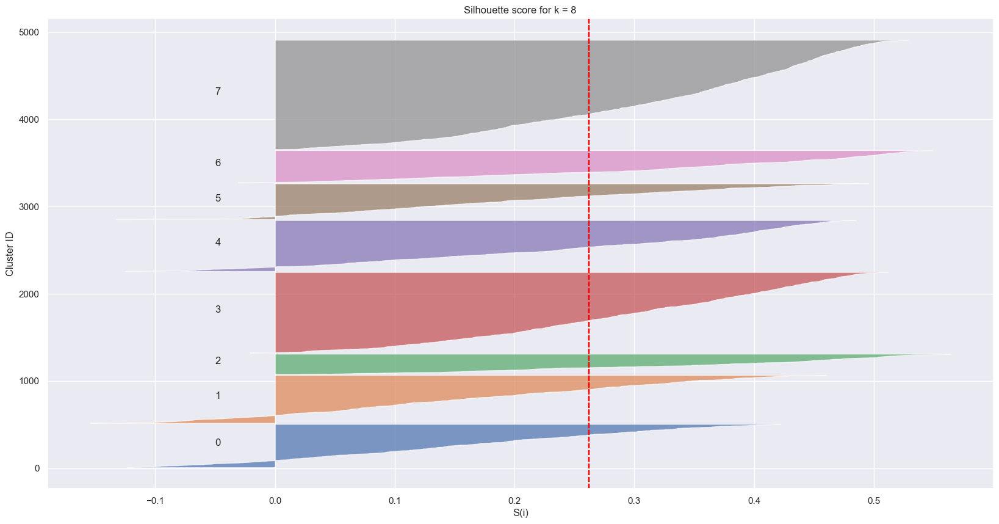

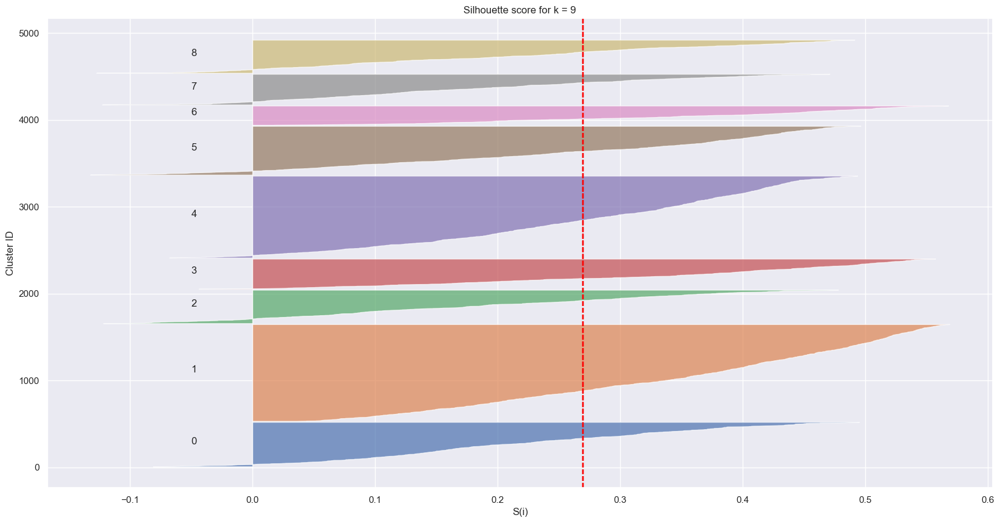

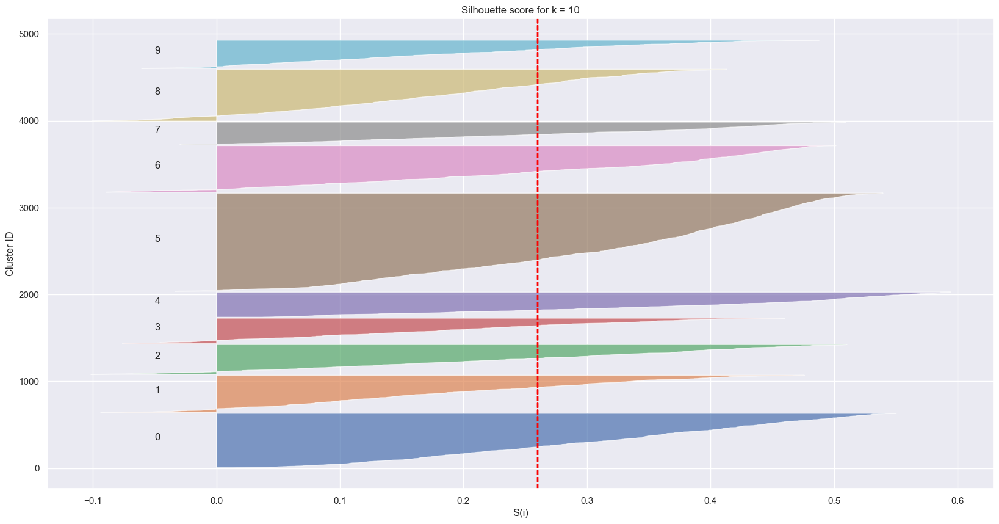

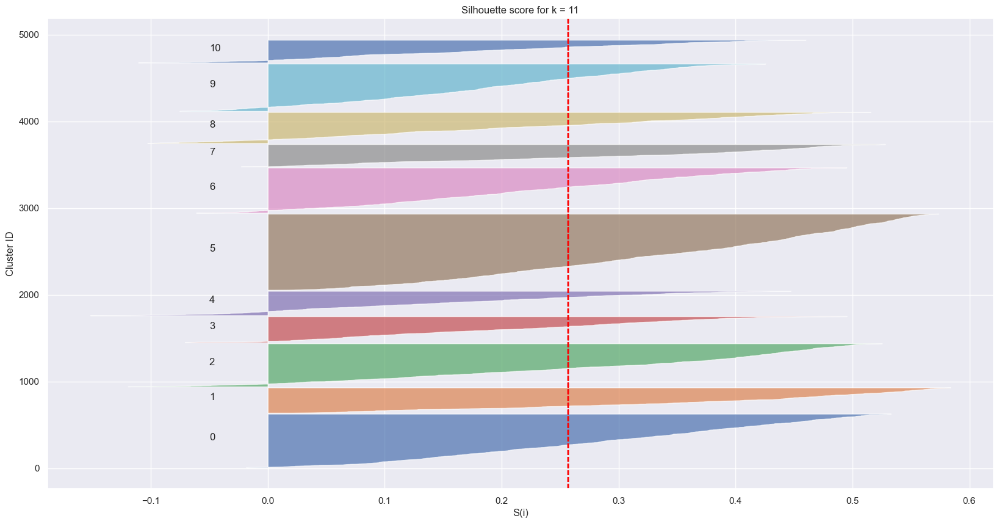

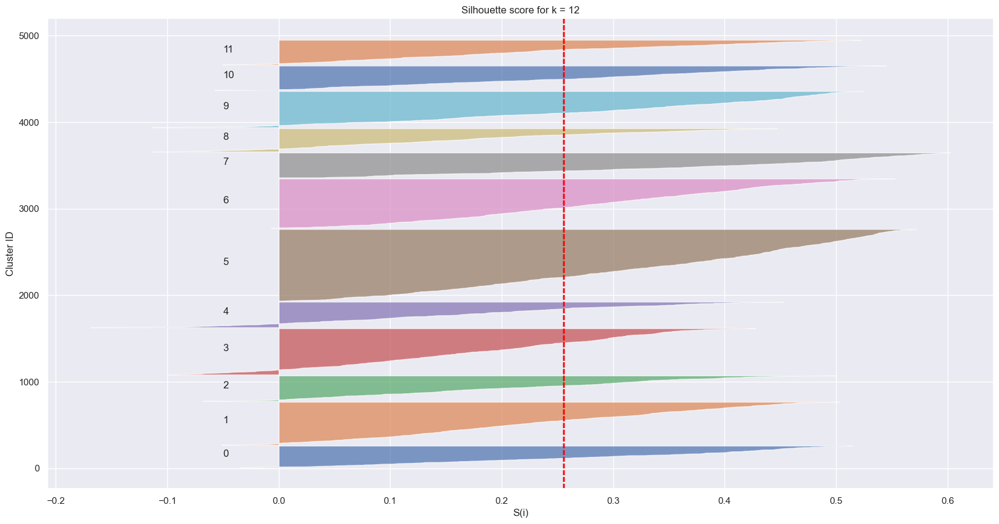

...

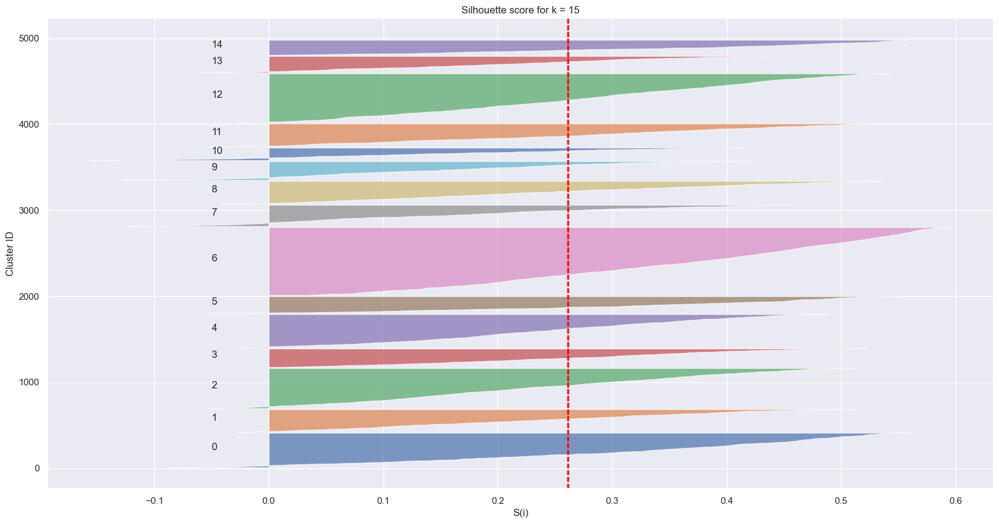

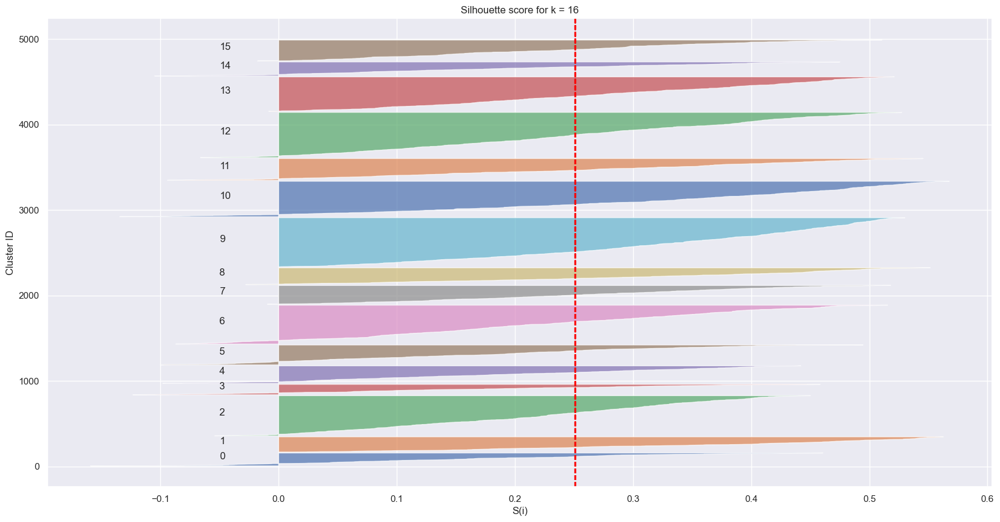

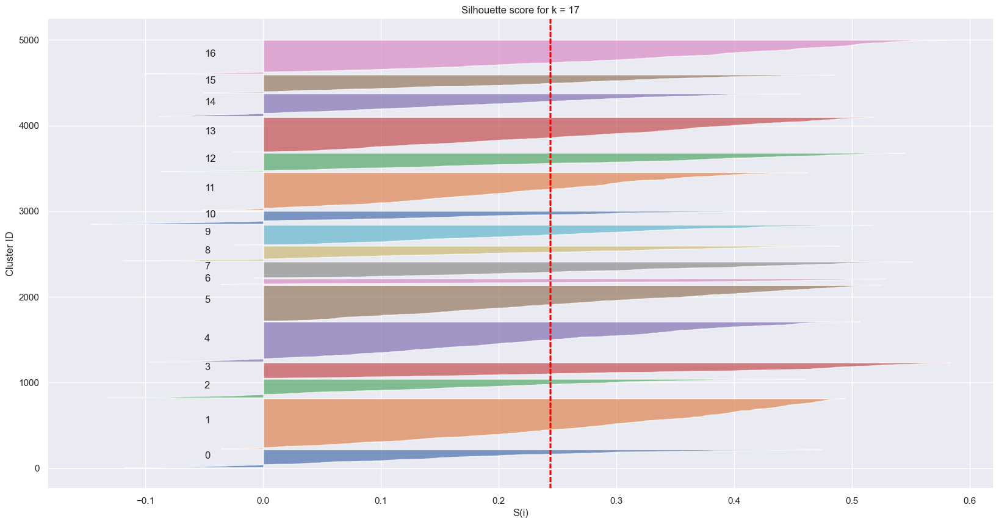

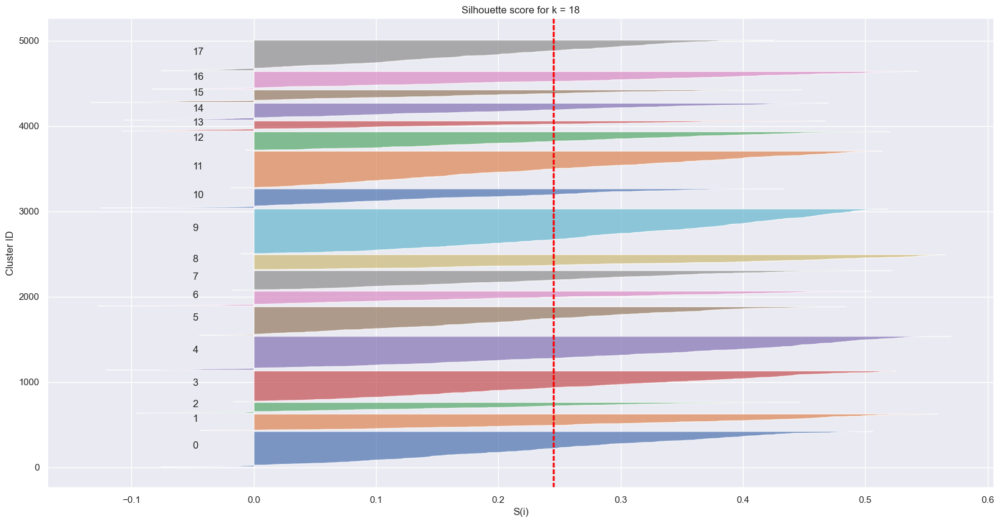

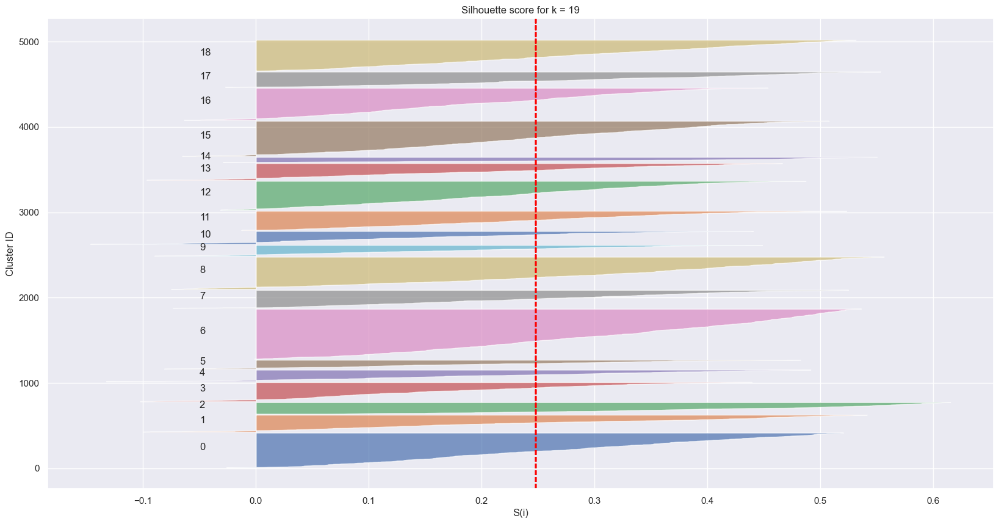

In [58]:
for k in range (8,20):

    run_kmean_allscalers(songs_c_df,k,"StandardScaler",draw=True)

[2675.73117, 0.24551]

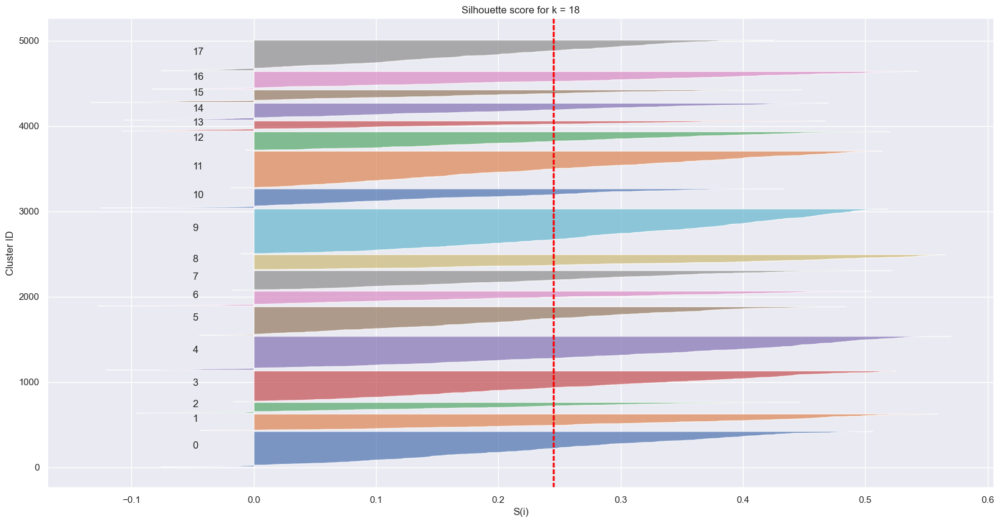

In [59]:


one_k =18
run_kmean_allscalers(songs_c_df,one_k,"StandardScaler",draw="True")


In [71]:
res=run_kmean_allscalers(songs_c_df,one_k,"StandardScaler",nearst_ith=20)

KeyError: "None of [Int64Index([2512, 4425, 4725, 4580,  678,  622, 4592, 2808, 2570, 2491, 2429,\n            2403, 4347, 4587, 4430, 2540, 4355, 1781, 1606, 1570],\n           dtype='int64')] are in the [columns]"

In [ ]:
res

### check number of songs/cluster 

In [60]:
songs_per_clus =[]
for i in range (one_k):
    songs_per_clus.append((i,(songs_df.clus_StandardScaler == i).sum()))

In [61]:
songs_per_clus

[(0, 415),
 (1, 194),
 (2, 126),
 (3, 359),
 (4, 396),
 (5, 336),
 (6, 174),
 (7, 230),
 (8, 177),
 (9, 526),
 (10, 226),
 (11, 431),
 (12, 217),
 (13, 117),
 (14, 198),
 (15, 146),
 (16, 206),
 (17, 358)]

In [69]:
songs_df.loc[songs_df.clus_StandardScaler == 9].drop(["danceability","key","loudness","mode","speechiness","instrumentalness","liveness","valence","duration_ms","time_signature"],axis=1).html

244     https://open.spotify.com/track/2PIC7KxAgHGYCGuGqcorw7
267     https://open.spotify.com/track/3VsYJCWecqxdwAN2Xu3cL5
270     https://open.spotify.com/track/3ZORmtq9HSYhdiyeeJyKHb
274     https://open.spotify.com/track/7JM85ZtL4IvNOmCFzWtKPS
284     https://open.spotify.com/track/4AlZ0FgehhgtLHddKx0Ou7
                                ...                          
5073    https://open.spotify.com/track/3GC7jZ05UuZVPNy2JMgPHf
5093    https://open.spotify.com/track/66IHTfRLQGiDuMXyCsLCJ3
5127    https://open.spotify.com/track/2yK4879j9Q1XnJio6ETqJV
5131    https://open.spotify.com/track/3yJdWQxmFO7nvNjEybCeYE
5134    https://open.spotify.com/track/5J0TvJIdYrybgk6SINgieR
Name: html, Length: 526, dtype: object

In [68]:
pd.set_option('display.max_colwidth', 80)

### Find nearest 50 points to each centroid